### Import

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import csv
import os
import sklearn 
from sklearn.preprocessing import MinMaxScaler 
from sklearn.preprocessing import Normalizer
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import r2_score, mean_absolute_error, silhouette_score
from sklearn.pipeline import make_pipeline 
from sklearn.preprocessing import PolynomialFeatures
# clustering
import scipy
from scipy.cluster.hierarchy import dendrogram, linkage
# from scipy.spatial.distance import dist
from sklearn.cluster import AgglomerativeClustering
import sklearn.metrics as sm
from sklearn.cluster import KMeans 
import itertools
from matplotlib import gridspec
from sklearn.cluster import cluster_optics_dbscan

In [2]:
# from google.colab import drive
# drive.mount('/content/drive')

### EDA and Preprocessing

In [3]:
df_processed = pd.read_csv('indexProcessed.csv')
df_info =pd.read_csv('indexInfo.csv')

In [4]:
df_info.head()

,Region,Exchange,Index,Currency
0,United States,New York Stock Exchange,NYA,USD
1,United States,NASDAQ,IXIC,USD
2,Hong Kong,Hong Kong Stock Exchange,HSI,HKD
3,China,Shanghai Stock Exchange,000001.SS,CNY
4,Japan,Tokyo Stock Exchange,N225,JPY


In [5]:
df_processed.head()

,Index,Date,Open,High,Low,Close,Adj Close,Volume,CloseUSD
0,HSI,1986-12-31,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006
1,HSI,1987-01-02,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013
2,HSI,1987-01-05,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987
3,HSI,1987-01-06,2583.899902,2583.899902,2583.899902,2583.899902,2583.899902,0.0,335.906987
4,HSI,1987-01-07,2607.100098,2607.100098,2607.100098,2607.100098,2607.100098,0.0,338.923013


In [6]:
df_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104224 entries, 0 to 104223
Data columns (total 9 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Index      104224 non-null  object 
 1   Date       104224 non-null  object 
 2   Open       104224 non-null  float64
 3   High       104224 non-null  float64
 4   Low        104224 non-null  float64
 5   Close      104224 non-null  float64
 6   Adj Close  104224 non-null  float64
 7   Volume     104224 non-null  float64
 8   CloseUSD   104224 non-null  float64
dtypes: float64(7), object(2)
memory usage: 7.2+ MB


In [7]:
df_processed.Date = pd.to_datetime(df_processed.Date)
df_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104224 entries, 0 to 104223
Data columns (total 9 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   Index      104224 non-null  object        
 1   Date       104224 non-null  datetime64[ns]
 2   Open       104224 non-null  float64       
 3   High       104224 non-null  float64       
 4   Low        104224 non-null  float64       
 5   Close      104224 non-null  float64       
 6   Adj Close  104224 non-null  float64       
 7   Volume     104224 non-null  float64       
 8   CloseUSD   104224 non-null  float64       
dtypes: datetime64[ns](1), float64(7), object(1)
memory usage: 7.2+ MB


In [8]:
index = np.unique(df_processed.Index)
print(index)

['000001.SS' '399001.SZ' 'GDAXI' 'GSPTSE' 'HSI' 'IXIC' 'J203.JO' 'N100'
 'N225' 'NSEI' 'NYA' 'SSMI' 'TWII']


In [9]:
company = df_processed['Index'].value_counts().index
company

Index(['NYA', 'N225', 'IXIC', 'GSPTSE', 'HSI', 'GDAXI', 'SSMI', 'TWII',
       '000001.SS', '399001.SZ', 'N100', 'NSEI', 'J203.JO'],
      dtype='object')

In [10]:
df_processed.head()

,Index,Date,Open,High,Low,Close,Adj Close,Volume,CloseUSD
0,HSI,1986-12-31,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006
1,HSI,1987-01-02,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013
2,HSI,1987-01-05,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987
3,HSI,1987-01-06,2583.899902,2583.899902,2583.899902,2583.899902,2583.899902,0.0,335.906987
4,HSI,1987-01-07,2607.100098,2607.100098,2607.100098,2607.100098,2607.100098,0.0,338.923013


In [11]:

import plotly.graph_objects as go

import pandas as pd
from datetime import datetime


fig = go.Figure(data=[go.Candlestick(x=df_processed.index,
                open=df_processed['Open'],
                high=df_processed['High'],
                low=df_processed['Low'],
                close=df_processed['Close'])])

# SHOW LEGEND

fig.update_layout(showlegend=True)

fig.show()

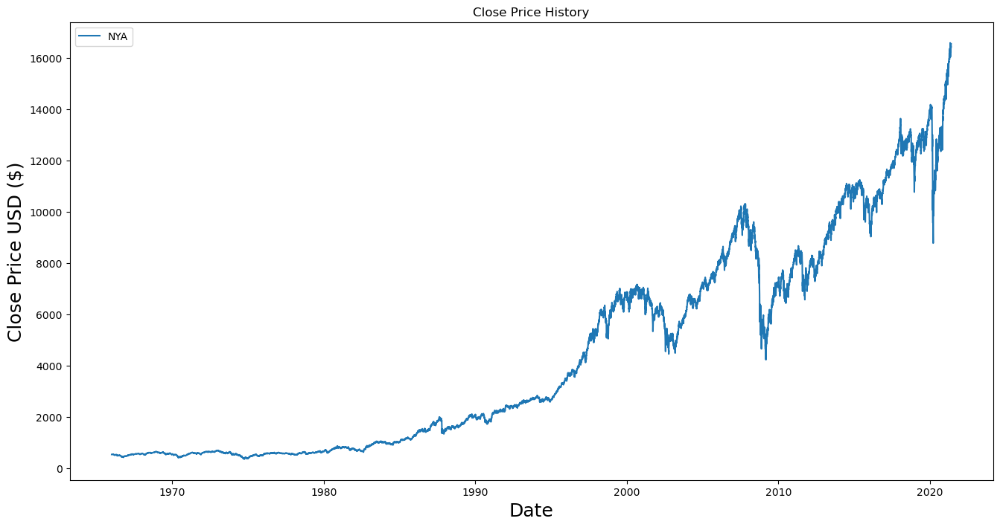

In [12]:
#plot graph of Adj Close vs Date(Year) for NYA company
plt.figure(figsize=(16,8))
plt.title('Close Price History')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Close Price USD ($)', fontsize=18)
# for i in company:
plt.plot(df_processed[df_processed['Index']=="NYA"]['Date'],df_processed[df_processed['Index']=="NYA"]['Close'])
plt.legend(company,loc='upper left')
plt.show()



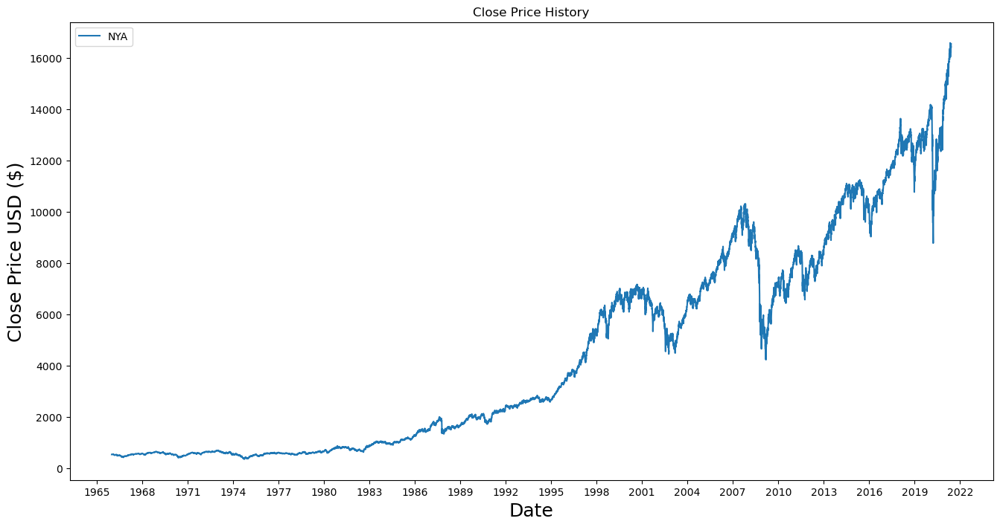

In [13]:
#show the Y label in years from the above graph
import matplotlib.dates as mdates
#every 3 years
years = mdates.YearLocator(3)   # every year
years_fmt = mdates.DateFormatter('%Y')

plt.figure(figsize=(16,8))
plt.title('Close Price History')
plt.xlabel('Date', fontsize=18)
plt.ylabel('Close Price USD ($)', fontsize=18)
# for i in company:
plt.plot(df_processed[df_processed['Index']=="NYA"]['Date'],df_processed[df_processed['Index']=="NYA"]['Close'])
plt.legend(company,loc='upper left')
plt.gca().xaxis.set_major_locator(years)
plt.gca().xaxis.set_major_formatter(years_fmt)
plt.show()



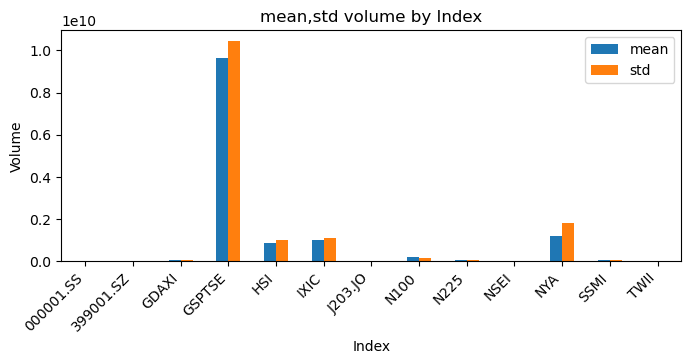

In [14]:
#Mean std deviation of the volume of each company
idx_date_group = df_processed.groupby('Index')['Date'].agg(['min', 'max'])
plot_var = ['mean', 'std']
idx_vol_group = df_processed.groupby('Index')['Volume'].agg(plot_var).reset_index()

idx_vol_group.plot(kind='bar', figsize=(8, 3))
plt.title(f'{",".join(plot_var)} volume by Index')
plt.xlabel('Index')
plt.ylabel('Volume')
plt.legend(plot_var)

# fetch the current ax object
ax = plt.gca()
ax.set_xticklabels(idx_vol_group['Index'], rotation=45, ha='right')

plt.show()

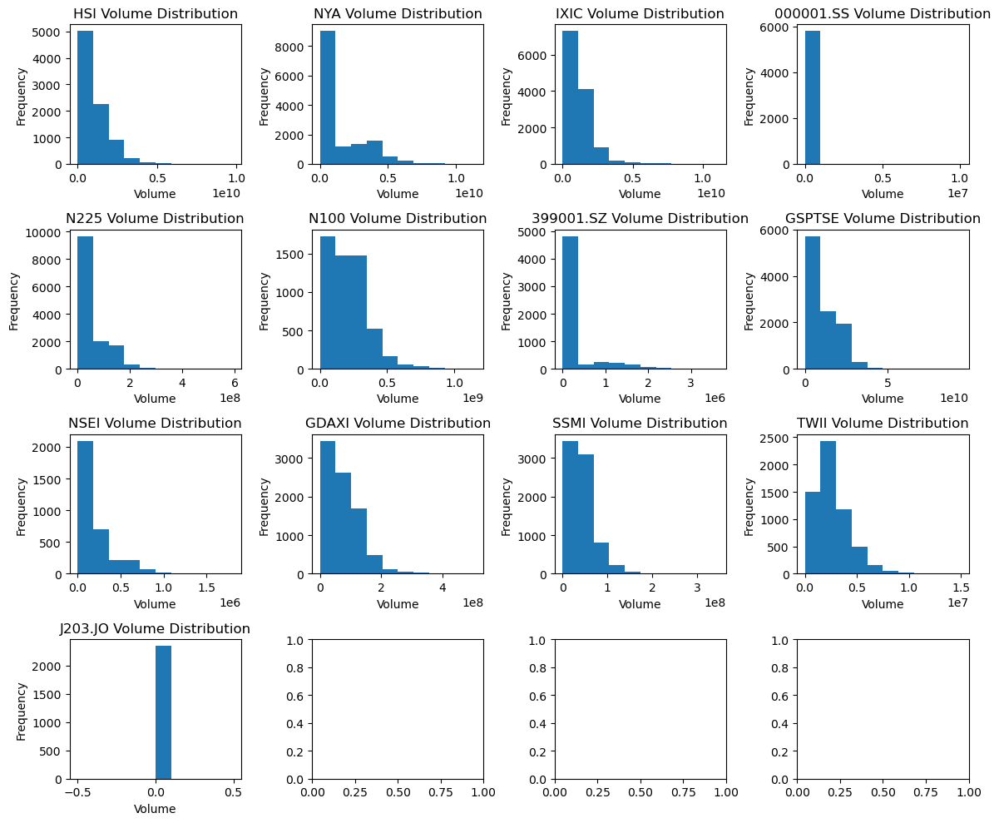

In [15]:
#volume Frequency Graph
ig, ax = plt.subplots(4, 4, figsize=(12, 10))

# iterate over index
index_list = df_processed['Index'].unique().tolist()
for i, (index, ax) in enumerate(zip(index_list, ax.flatten())):
    index_data = df_processed[df_processed['Index'] == index]['Volume']

    # histogram plot
    ax.hist(index_data, bins=10)
    ax.set_title(f"{index} Volume Distribution")

    # set labels
    ax.set_xlabel('Volume')
    ax.set_ylabel('Frequency')
    plt.tight_layout()

plt.show()

In [16]:
df_NYA = pd.DataFrame(df_processed[df_processed.Index == 'NYA'])
df_N225 = pd.DataFrame(df_processed[df_processed.Index == 'N225'])
df_IXIC = pd.DataFrame(df_processed[df_processed.Index == 'IXIC'])
df_GSPTSE = pd.DataFrame(df_processed[df_processed.Index == 'GSPTSE'])

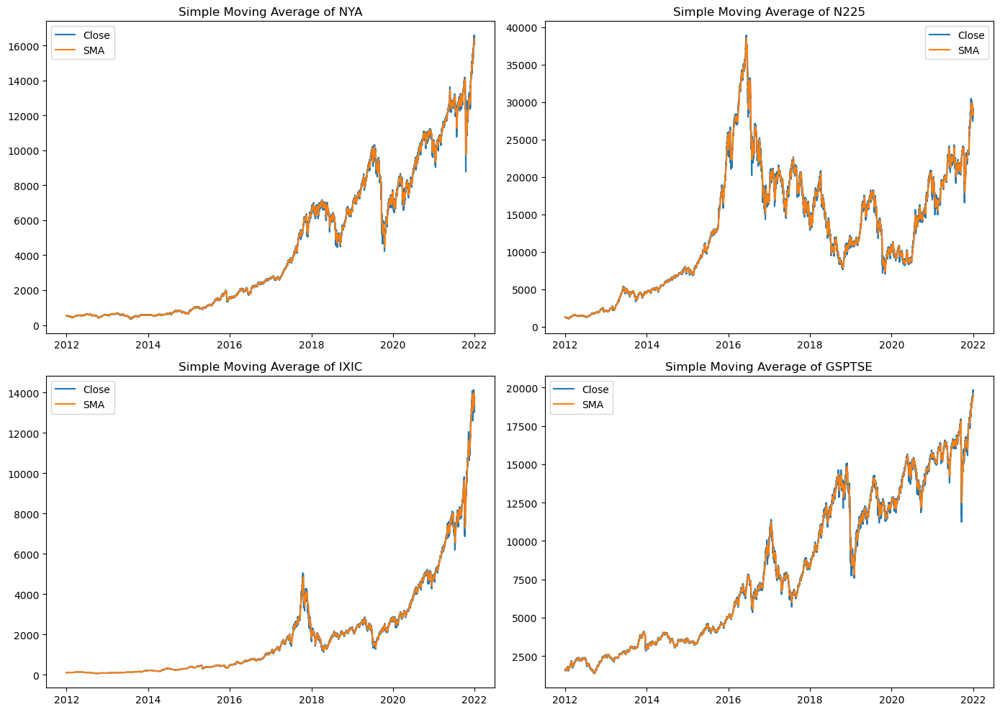

In [17]:
# Compute SMAs
df_NYA['SMA_close'] = df_NYA['Close'].rolling(window=12, min_periods=1).mean()
df_N225['SMA_close'] = df_N225['Close'].rolling(window=12, min_periods=1).mean()
df_IXIC['SMA_close'] = df_IXIC['Close'].rolling(window=12, min_periods=1).mean()
df_GSPTSE['SMA_close'] = df_GSPTSE['Close'].rolling(window=12, min_periods=1).mean()


# Create subplots
fig, ax = plt.subplots(2, 2, figsize=(14, 10))

start_date = pd.to_datetime('2012-01-01')
end_date = pd.to_datetime('2022-01-01')

# Generate 100 equally spaced numbers between 0 and 1
scaled_numbers = np.linspace(0, 1,len(df_NYA['Close']))

# Scale the numbers to the desired date range
date_range = start_date + (end_date - start_date) * scaled_numbers

# Convert the scaled numbers to timestamps
timestamps = pd.to_datetime(date_range)

ax[0,0].plot(timestamps,df_NYA['Close'],label='Close')
ax[0,0].plot(timestamps,df_NYA['SMA_close'],label='SMA')
ax[0,0].set_title('Simple Moving Average of NYA')
ax[0,0].legend()

#-----------------------------------------------

scaled_numbers = np.linspace(0, 1,len(df_N225['Close']))

# Scale the numbers to the desired date range
date_range = start_date + (end_date - start_date) * scaled_numbers

# Convert the scaled numbers to timestamps
timestamps = pd.to_datetime(date_range)

ax[0,1].plot(timestamps,df_N225['Close'],label='Close')
ax[0,1].plot(timestamps,df_N225['SMA_close'],label='SMA')
ax[0,1].set_title('Simple Moving Average of N225')
ax[0,1].legend()

#-----------------------------------------------


scaled_numbers = np.linspace(0, 1,len(df_IXIC['Close']))

# Scale the numbers to the desired date range
date_range = start_date + (end_date - start_date) * scaled_numbers

# Convert the scaled numbers to timestamps
timestamps = pd.to_datetime(date_range)

ax[1,0].plot(timestamps,df_IXIC['Close'],label='Close')
ax[1,0].plot(timestamps,df_IXIC['SMA_close'],label='SMA')
ax[1,0].set_title('Simple Moving Average of IXIC')
ax[1,0].legend()

#-----------------------------------------------


scaled_numbers = np.linspace(0, 1,len(df_GSPTSE['Close']))

# Scale the numbers to the desired date range
date_range = start_date + (end_date - start_date) * scaled_numbers

# Convert the scaled numbers to timestamps
timestamps = pd.to_datetime(date_range)

ax[1,1].plot(timestamps,df_GSPTSE['Close'],label='Close')
ax[1,1].plot(timestamps,df_GSPTSE['SMA_close'],label='SMA')
ax[1,1].set_title('Simple Moving Average of GSPTSE')
ax[1,1].legend()

#-----------------------------------------------
# Adjust the layout
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'GSPTSE')

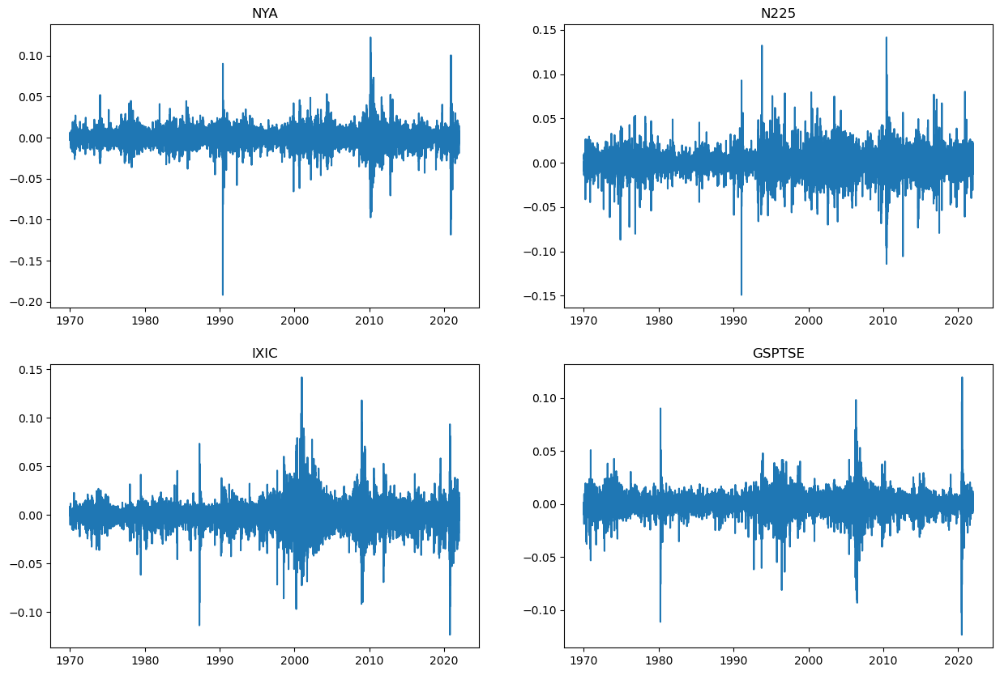

In [18]:
fig, ax = plt.subplots(2,2)
d_return = {}
for comp in company[:4]:
    d_return[comp] = df_processed[df_processed.Index == comp]['Adj Close'].pct_change()
fig.set_figheight(10)
fig.set_figwidth(15)

start_date = pd.to_datetime('1970-01-01')
end_date = pd.to_datetime('2022-01-01')
scaled_numbers = np.linspace(0, 1,len(d_return[company[0]]))
date_range = start_date + (end_date - start_date) * scaled_numbers
timestamps = pd.to_datetime(date_range)
ax[0,0].plot(timestamps,d_return[company[0]])
ax[0,0].set_title('NYA')



start_date = pd.to_datetime('1970-01-01')
end_date = pd.to_datetime('2022-01-01')
scaled_numbers = np.linspace(0, 1,len(d_return[company[1]]))
date_range = start_date + (end_date - start_date) * scaled_numbers
timestamps = pd.to_datetime(date_range)
ax[0,1].plot(timestamps,d_return[company[1]])
ax[0,1].set_title('N225')

start_date = pd.to_datetime('1970-01-01')
end_date = pd.to_datetime('2022-01-01')
scaled_numbers = np.linspace(0, 1,len(d_return[company[2]]))
date_range = start_date + (end_date - start_date) * scaled_numbers
timestamps = pd.to_datetime(date_range)
ax[1,0].plot(timestamps,d_return[company[2]])
ax[1,0].set_title('IXIC')

start_date = pd.to_datetime('1970-01-01')
end_date = pd.to_datetime('2022-01-01')
scaled_numbers = np.linspace(0, 1,len(d_return[company[3]]))
date_range = start_date + (end_date - start_date) * scaled_numbers
timestamps = pd.to_datetime(date_range)
ax[1,1].plot(timestamps,d_return[company[3]])
ax[1,1].set_title('GSPTSE')



<AxesSubplot:ylabel='Index'>

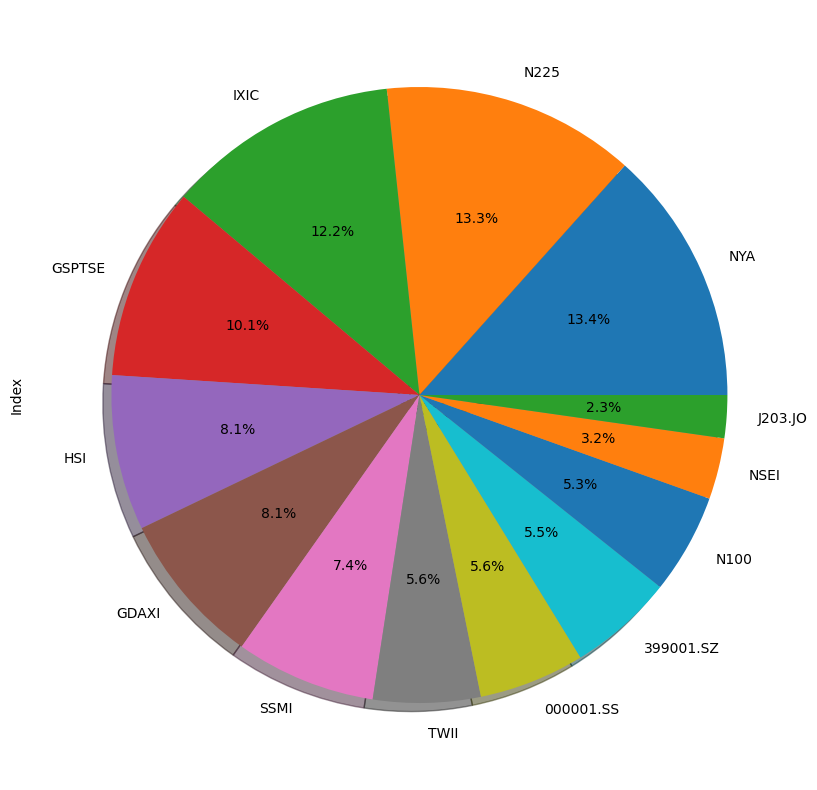

In [19]:
plt.figure(figsize=(10,10))
df_processed.Index.value_counts().plot.pie(autopct='%1.1f%%',shadow=True)

In [20]:
df_processed.shape


(104224, 9)

In [21]:
df_merged = df_processed.merge(df_info, how='outer', on='Index')
# df_merged['Date'] = pd.to_datetime(df_merged['Date'])
df_merged.set_index('Date', inplace=True)
df_merged.head(3)

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency
Date,,,,,,,,,,,
1986-12-31,HSI,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006,Hong Kong,Hong Kong Stock Exchange,HKD
1987-01-02,HSI,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013,Hong Kong,Hong Kong Stock Exchange,HKD
1987-01-05,HSI,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987,Hong Kong,Hong Kong Stock Exchange,HKD


In [22]:
df_merged.shape

(104225, 11)

In [23]:
df = df_merged.dropna()
df.shape

(104224, 11)

In [24]:
ls_index = df.Index.unique()
ls_index

array(['HSI', 'NYA', 'IXIC', '000001.SS', 'N225', 'N100', '399001.SZ',
       'GSPTSE', 'NSEI', 'GDAXI', 'SSMI', 'TWII', 'J203.JO'], dtype=object)

In [25]:
def plot(df,col):
    data = df.loc[df['Index'] == col]

    fig, ax = plt.subplots(1,3, figsize=(18,6), tight_layout=True)

    ax[0].set_title("Change in Open price of" + col)
    data['Open'].plot(label=col, ax = ax[0], alpha=0.5)
    ax[0].set_ylabel('Open Price')


    ax[1].set_title('Change in Close price of ' + col)
    data['Close'].plot(label=col, ax=ax[1], alpha=0.5)
    ax[1].set_ylabel('Close Price')


    ax[2].set_title('Trading Volume price of ' + col)
    data['Volume'].plot(label=col, ax=ax[2], alpha=0.5)
    ax[2].set_ylabel('Volume')


    plt.show()

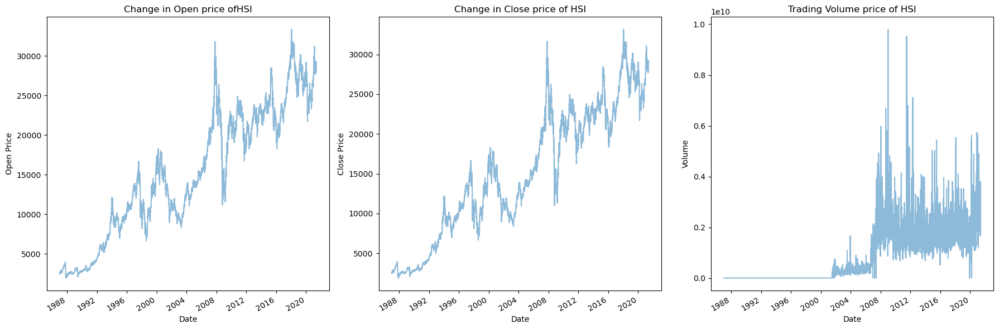

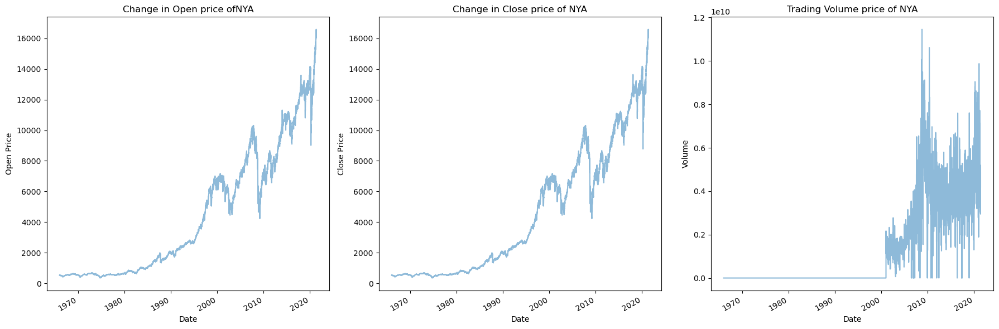

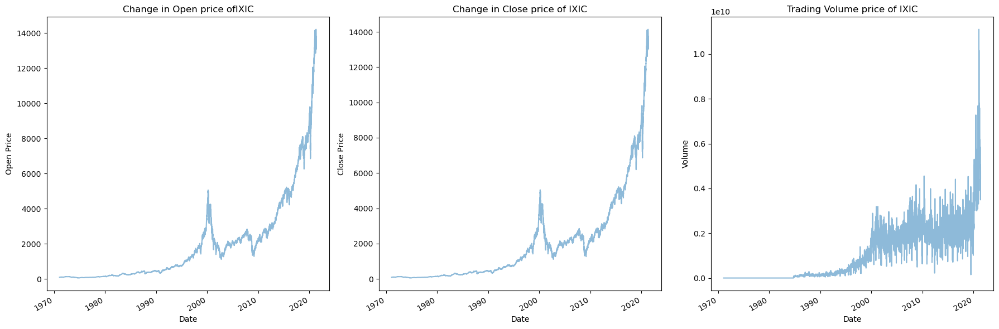

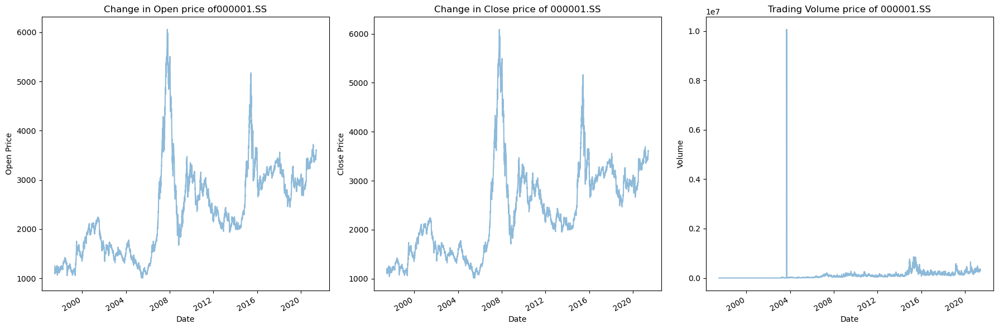

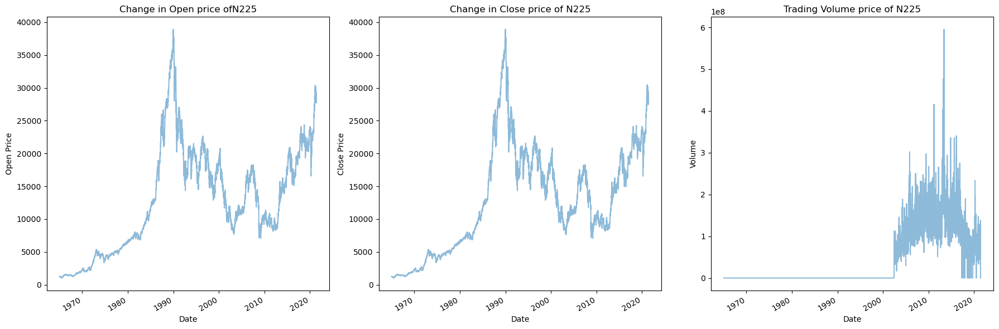

...

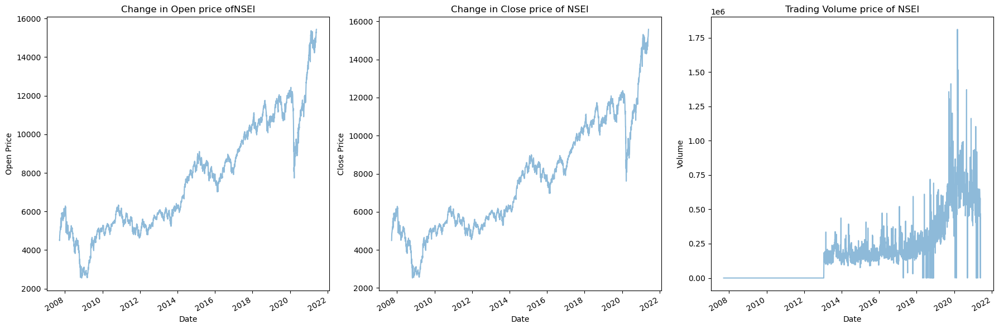

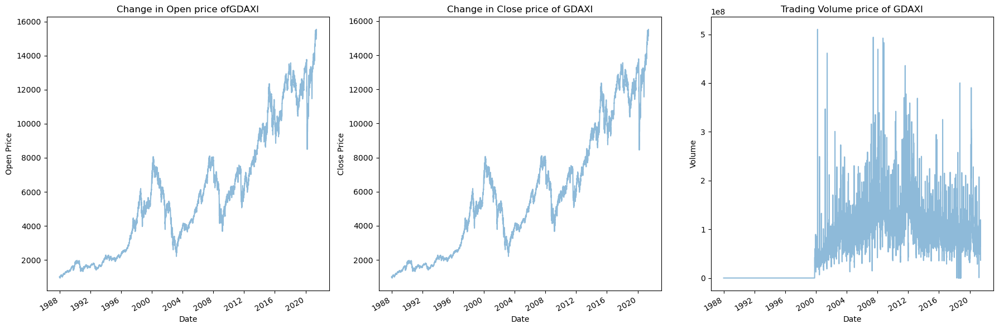

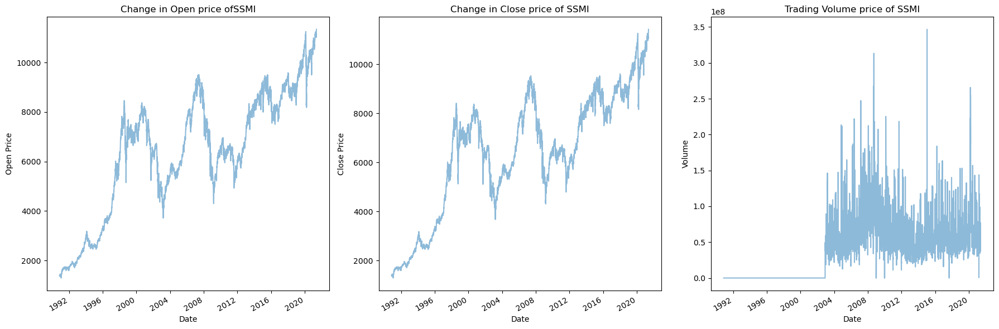

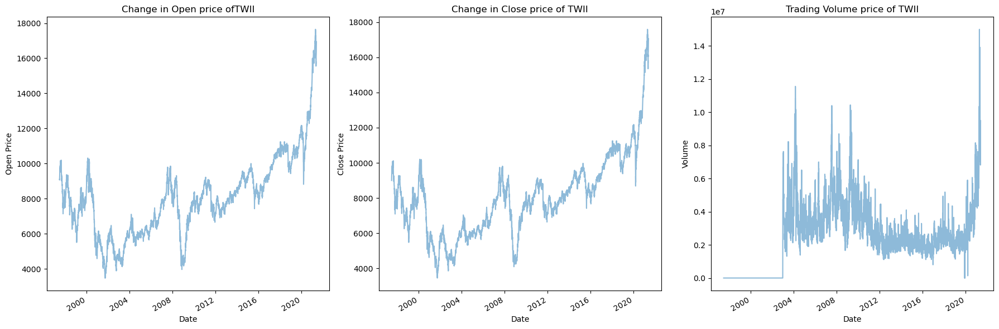

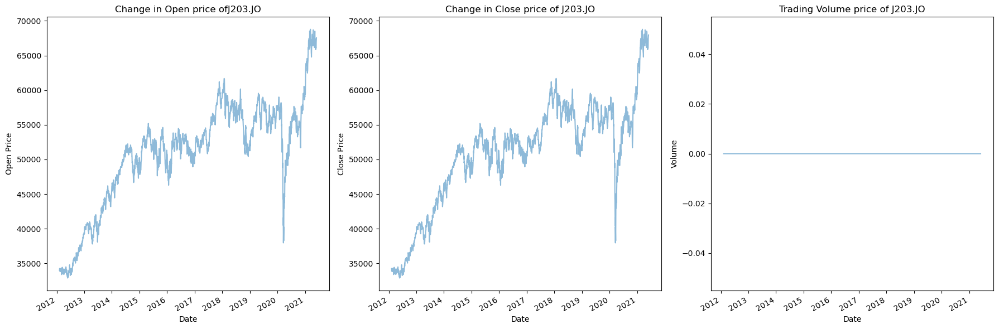

In [26]:
for idx in ls_index:
    plot(df,idx)

<AxesSubplot:ylabel='Index'>

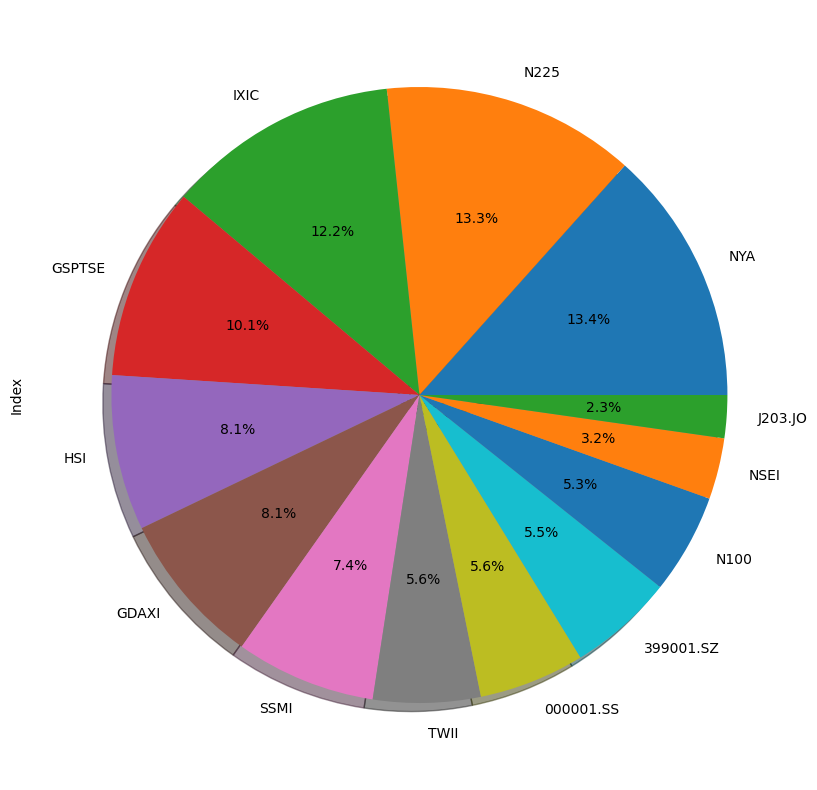

In [27]:
plt.figure(figsize=(10,10))
df.Index.value_counts().plot.pie(autopct='%1.1f%%',shadow=True)

In [28]:
df['High']

Date
1986-12-31     2568.300049
1987-01-02     2540.100098
1987-01-05     2552.399902
1987-01-06     2583.899902
1987-01-07     2607.100098
                  ...     
2021-05-25    66812.453130
2021-05-26    66446.367190
2021-05-27    66940.250000
2021-05-28    67726.562500
2021-05-31    68140.851560
Name: High, Length: 104224, dtype: float64

In [29]:
df['open-high'] = df['Open']-df['High']
df['open-low'] = df['Open'] - df['Low']
df['close-high'] = df['Close']-df['High']
df['close-low'] = df['Close'] - df['Low']
df['high-low'] = df['High'] - df['Low']
df['open-close'] = df['Open'] - df['Close']
df.head()

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/2952302642.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/2952302642.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/2952302642.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,,,,,
1986-12-31,HSI,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-02,HSI,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-05,HSI,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-06,HSI,2583.899902,2583.899902,2583.899902,2583.899902,2583.899902,0.0,335.906987,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-07,HSI,2607.100098,2607.100098,2607.100098,2607.100098,2607.100098,0.0,338.923013,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0


In [30]:
df.tail(5)

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,,,,,
2021-05-25,J203.JO,66054.92188,66812.45313,66022.97656,66076.67969,66076.67969,0.0,4625.367578,South Africa,Johannesburg Stock Exchange,ZAR,-757.53125,31.94532,-735.77344,53.70313,789.47657,-21.75781
2021-05-26,J203.JO,66076.67969,66446.36719,66030.35156,66108.22656,66108.22656,0.0,4627.575859,South Africa,Johannesburg Stock Exchange,ZAR,-369.68750,46.32813,-338.14063,77.87500,416.01563,-31.54687
2021-05-27,J203.JO,66108.22656,66940.25000,66102.54688,66940.25000,66940.25000,0.0,4685.817500,South Africa,Johannesburg Stock Exchange,ZAR,-832.02344,5.67968,0.00000,837.70312,837.70312,-832.02344
2021-05-28,J203.JO,66940.25000,67726.56250,66794.60938,67554.85938,67554.85938,0.0,4728.840157,South Africa,Johannesburg Stock Exchange,ZAR,-786.31250,145.64062,-171.70312,760.25000,931.95312,-614.60938
2021-05-31,J203.JO,67554.85938,68140.85156,67554.85938,67964.03906,67964.03906,0.0,4757.482734,South Africa,Johannesburg Stock Exchange,ZAR,-585.99218,0.00000,-176.81250,409.17968,585.99218,-409.17968


<AxesSubplot:>

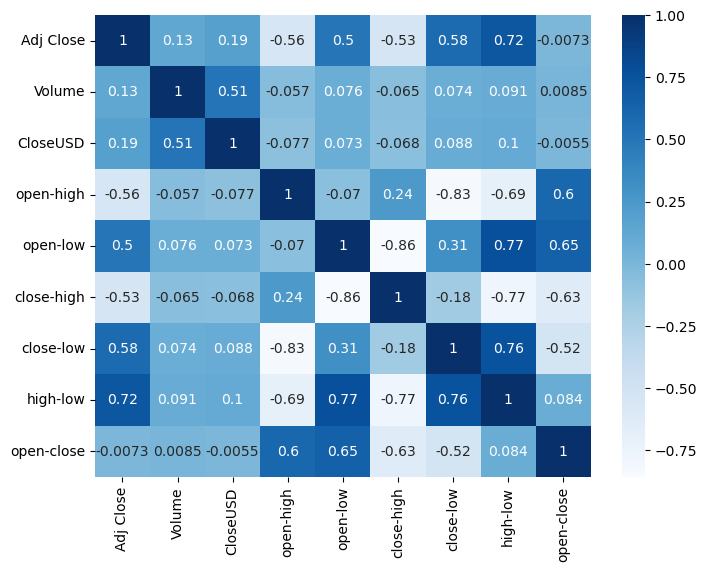

In [31]:
data2 = df.copy()
data2 = data2.drop(['Open','High','Low', 'Close', 'Region', 'Currency', 'Exchange'],axis=1)
plt.figure(figsize=(8,6))
sns.heatmap(data2.corr(),cmap='Blues',annot=True)

In [32]:
df.columns

Index(['Index', 'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'CloseUSD', 'Region', 'Exchange', 'Currency', 'open-high', 'open-low',
       'close-high', 'close-low', 'high-low', 'open-close'],
      dtype='object')

In [33]:
columns = ['Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
       'CloseUSD', 'open-high', 'open-low',
       'close-high', 'close-low', 'high-low', 'open-close']

In [34]:
df

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,,,,,
1986-12-31,HSI,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006,Hong Kong,Hong Kong Stock Exchange,HKD,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-02,HSI,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013,Hong Kong,Hong Kong Stock Exchange,HKD,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-05,HSI,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987,Hong Kong,Hong Kong Stock Exchange,HKD,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-06,HSI,2583.899902,2583.899902,2583.899902,2583.899902,2583.899902,0.0,335.906987,Hong Kong,Hong Kong Stock Exchange,HKD,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-07,HSI,2607.100098,2607.100098,2607.100098,2607.100098,2607.100098,0.0,338.923013,Hong Kong,Hong Kong Stock Exchange,HKD,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-05-25,J203.JO,66054.921880,66812.453130,66022.976560,66076.679690,66076.679690,0.0,4625.367578,South Africa,Johannesburg Stock Exchange,ZAR,-757.53125,31.94532,-735.77344,53.70313,789.47657,-21.75781
2021-05-26,J203.JO,66076.679690,66446.367190,66030.351560,66108.226560,66108.226560,0.0,4627.575859,South Africa,Johannesburg Stock Exchange,ZAR,-369.68750,46.32813,-338.14063,77.87500,416.01563,-31.54687
2021-05-27,J203.JO,66108.226560,66940.250000,66102.546880,66940.250000,66940.250000,0.0,4685.817500,South Africa,Johannesburg Stock Exchange,ZAR,-832.02344,5.67968,0.00000,837.70312,837.70312,-832.02344


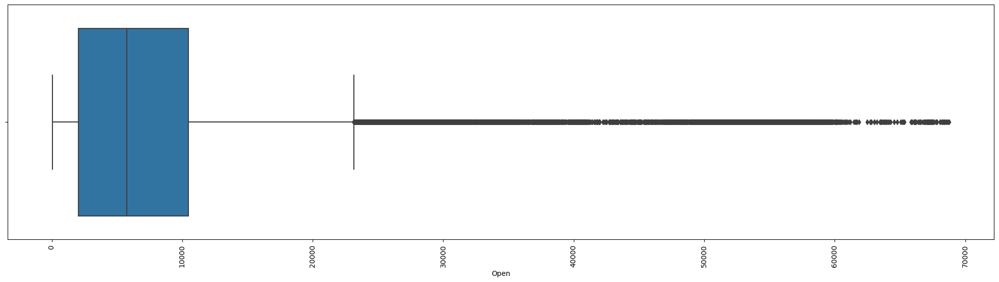

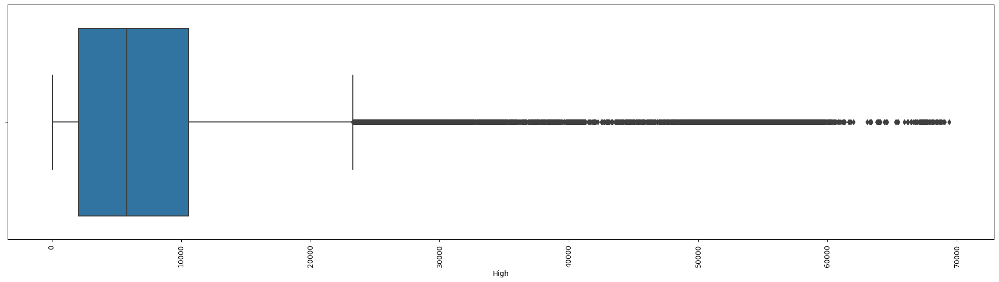

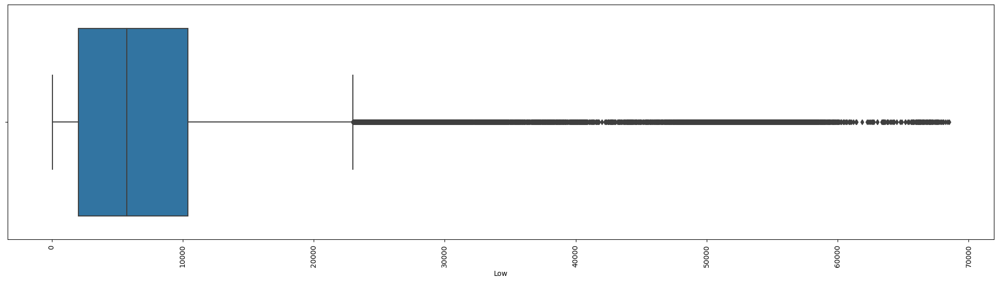

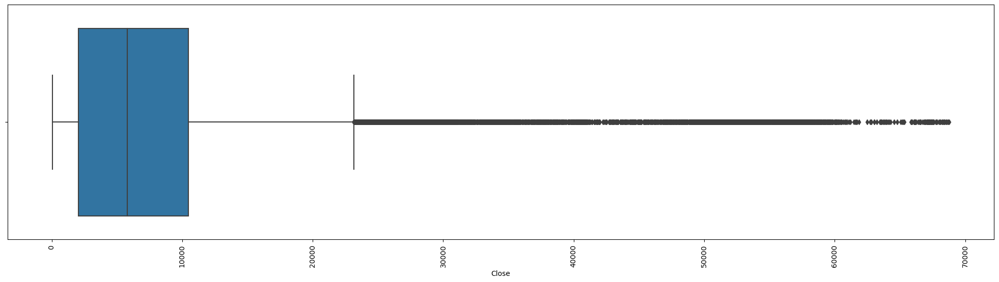

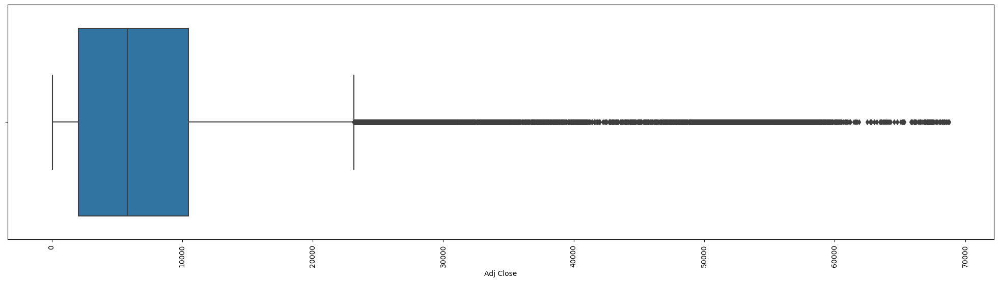

...

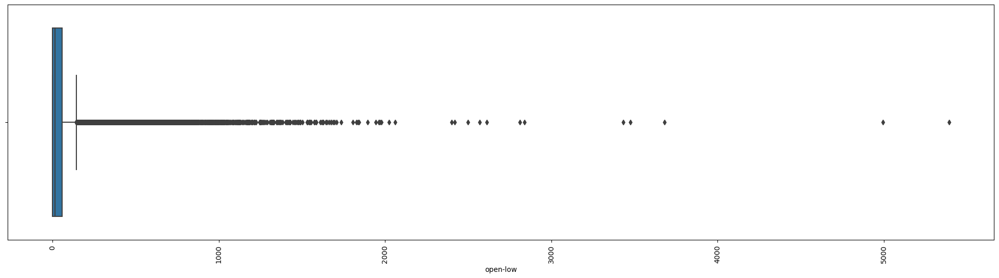

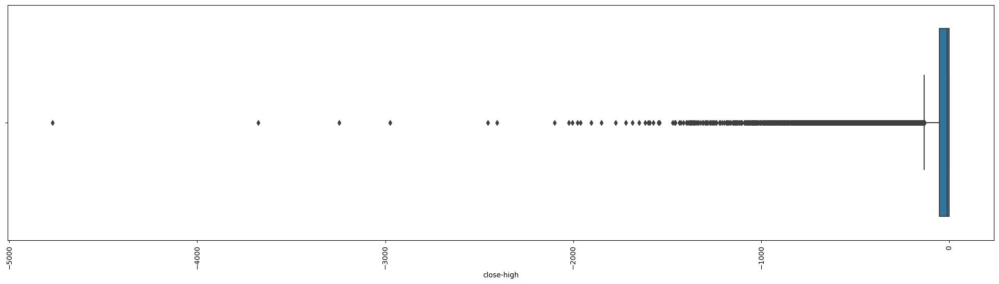

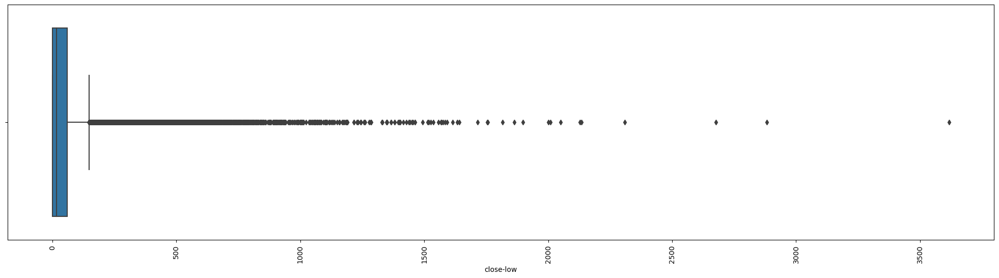

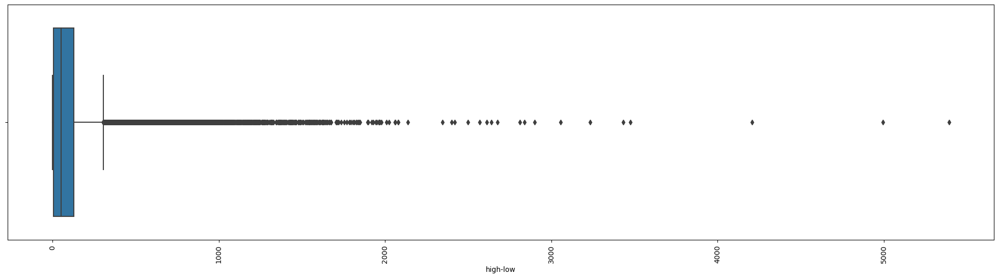

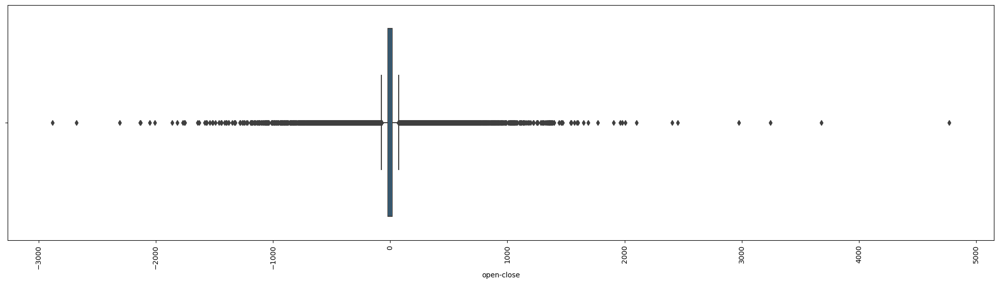

In [35]:
for column in columns:
    plt.figure(figsize = (25,6))
    sns.boxplot(x= df[column])
    plt.xticks(rotation=90)
    plt.show()

In [36]:
data2

,Index,Adj Close,Volume,CloseUSD,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,
1986-12-31,HSI,2568.300049,0.0,333.879006,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-02,HSI,2540.100098,0.0,330.213013,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-05,HSI,2552.399902,0.0,331.811987,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-06,HSI,2583.899902,0.0,335.906987,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1987-01-07,HSI,2607.100098,0.0,338.923013,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...
2021-05-25,J203.JO,66076.679690,0.0,4625.367578,-757.53125,31.94532,-735.77344,53.70313,789.47657,-21.75781
2021-05-26,J203.JO,66108.226560,0.0,4627.575859,-369.68750,46.32813,-338.14063,77.87500,416.01563,-31.54687
2021-05-27,J203.JO,66940.250000,0.0,4685.817500,-832.02344,5.67968,0.00000,837.70312,837.70312,-832.02344


In [37]:
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()

# fit and transform the column(s) to be encoded
data2['Index'] = le.fit_transform(data2['Index'])

In [38]:
data2.head()

,Index,Adj Close,Volume,CloseUSD,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,
1986-12-31,4,2568.300049,0.0,333.879006,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-02,4,2540.100098,0.0,330.213013,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-05,4,2552.399902,0.0,331.811987,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-06,4,2583.899902,0.0,335.906987,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-07,4,2607.100098,0.0,338.923013,0.0,0.0,0.0,0.0,0.0,0.0


### FINAL PROJECT

In [39]:
df_NYA = df[df['Index'] == 'NYA']
df_NYA.head()

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,,,,,
1965-12-31,NYA,528.690002,528.690002,528.690002,528.690002,528.690002,0.0,528.690002,United States,New York Stock Exchange,USD,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-03,NYA,527.210022,527.210022,527.210022,527.210022,527.210022,0.0,527.210022,United States,New York Stock Exchange,USD,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-04,NYA,527.840027,527.840027,527.840027,527.840027,527.840027,0.0,527.840027,United States,New York Stock Exchange,USD,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-05,NYA,531.119995,531.119995,531.119995,531.119995,531.119995,0.0,531.119995,United States,New York Stock Exchange,USD,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-06,NYA,532.070007,532.070007,532.070007,532.070007,532.070007,0.0,532.070007,United States,New York Stock Exchange,USD,0.0,0.0,0.0,0.0,0.0,0.0


In [40]:
#drop region, exchange, currency from df_nya    
df_NYA = df_NYA.drop(['Region', 'Currency', 'Exchange', 'Index'], axis=1)

In [41]:
df_NYA.head()

,Open,High,Low,Close,Adj Close,Volume,CloseUSD,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,
1965-12-31,528.690002,528.690002,528.690002,528.690002,528.690002,0.0,528.690002,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-03,527.210022,527.210022,527.210022,527.210022,527.210022,0.0,527.210022,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-04,527.840027,527.840027,527.840027,527.840027,527.840027,0.0,527.840027,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-05,531.119995,531.119995,531.119995,531.119995,531.119995,0.0,531.119995,0.0,0.0,0.0,0.0,0.0,0.0
1966-01-06,532.070007,532.070007,532.070007,532.070007,532.070007,0.0,532.070007,0.0,0.0,0.0,0.0,0.0,0.0


In [42]:
df.head()

,Index,Open,High,Low,Close,Adj Close,Volume,CloseUSD,Region,Exchange,Currency,open-high,open-low,close-high,close-low,high-low,open-close
Date,,,,,,,,,,,,,,,,,
1986-12-31,HSI,2568.300049,2568.300049,2568.300049,2568.300049,2568.300049,0.0,333.879006,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-02,HSI,2540.100098,2540.100098,2540.100098,2540.100098,2540.100098,0.0,330.213013,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-05,HSI,2552.399902,2552.399902,2552.399902,2552.399902,2552.399902,0.0,331.811987,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-06,HSI,2583.899902,2583.899902,2583.899902,2583.899902,2583.899902,0.0,335.906987,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0
1987-01-07,HSI,2607.100098,2607.100098,2607.100098,2607.100098,2607.100098,0.0,338.923013,Hong Kong,Hong Kong Stock Exchange,HKD,0.0,0.0,0.0,0.0,0.0,0.0


In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 104224 entries, 1986-12-31 to 2021-05-31
Data columns (total 17 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Index       104224 non-null  object 
 1   Open        104224 non-null  float64
 2   High        104224 non-null  float64
 3   Low         104224 non-null  float64
 4   Close       104224 non-null  float64
 5   Adj Close   104224 non-null  float64
 6   Volume      104224 non-null  float64
 7   CloseUSD    104224 non-null  float64
 8   Region      104224 non-null  object 
 9   Exchange    104224 non-null  object 
 10  Currency    104224 non-null  object 
 11  open-high   104224 non-null  float64
 12  open-low    104224 non-null  float64
 13  close-high  104224 non-null  float64
 14  close-low   104224 non-null  float64
 15  high-low    104224 non-null  float64
 16  open-close  104224 non-null  float64
dtypes: float64(13), object(4)
memory usage: 14.3+ MB


### Linear Regression

In [44]:
def calculate_metrics(pred, y_test):
    mae = mean_absolute_error(y_test, pred)
    rmse = np.sqrt(mae)
    r2 = r2_score(y_test,pred)

    results = {
        'R^2': round(r2,3),
        'MAE': round(mae,5),
        'RMSE': round(rmse,3)
    }
    print(results)
    return results

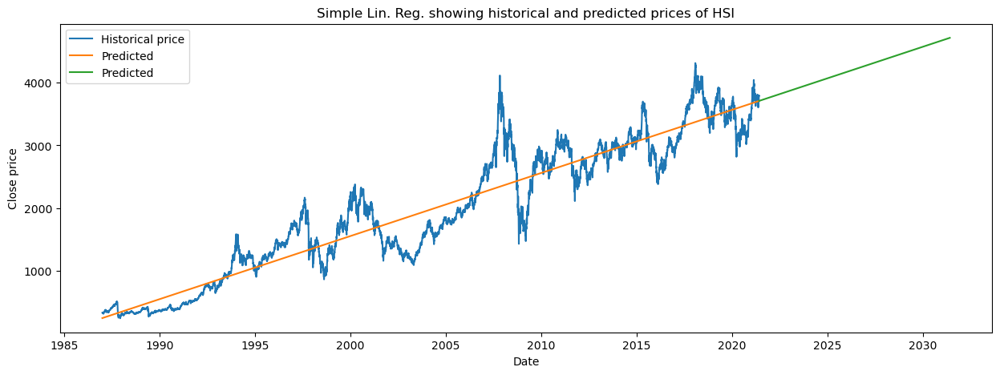

R-squared score HSI : 0.8931274509759525
Accuracy score HSI : 0.8931274509759525


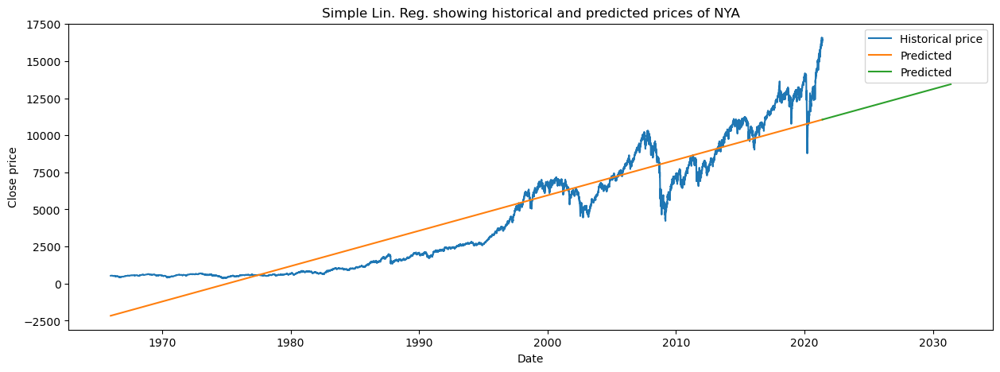

R-squared score NYA : 0.8747463685113148
Accuracy score NYA : 0.8747463685113148


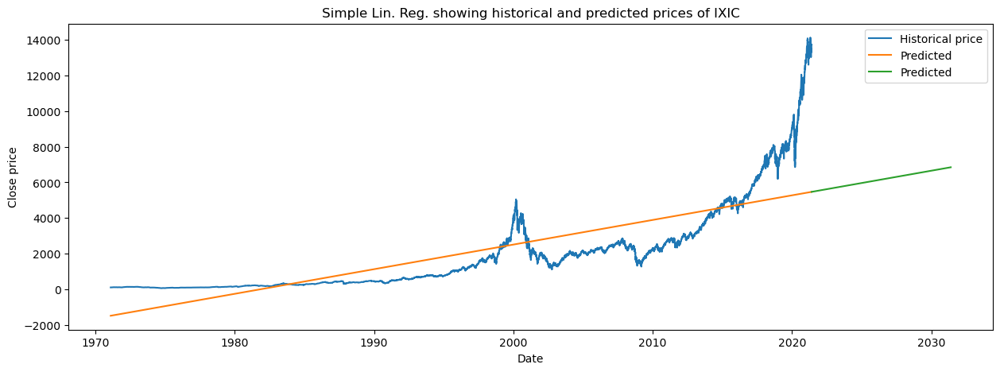

R-squared score IXIC : 0.6501269545473617
Accuracy score IXIC : 0.6501269545473617


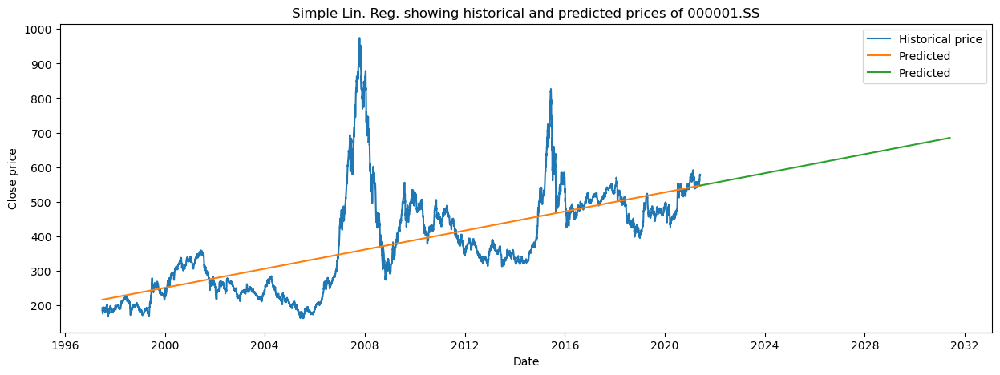

R-squared score 000001.SS : 0.4251333304983649
Accuracy score 000001.SS : 0.4251333304983649


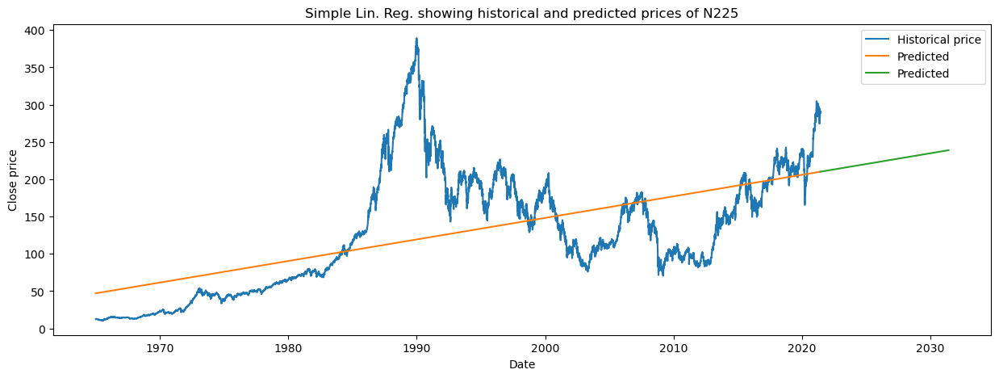

R-squared score N225 : 0.34260595616665335
Accuracy score N225 : 0.34260595616665335


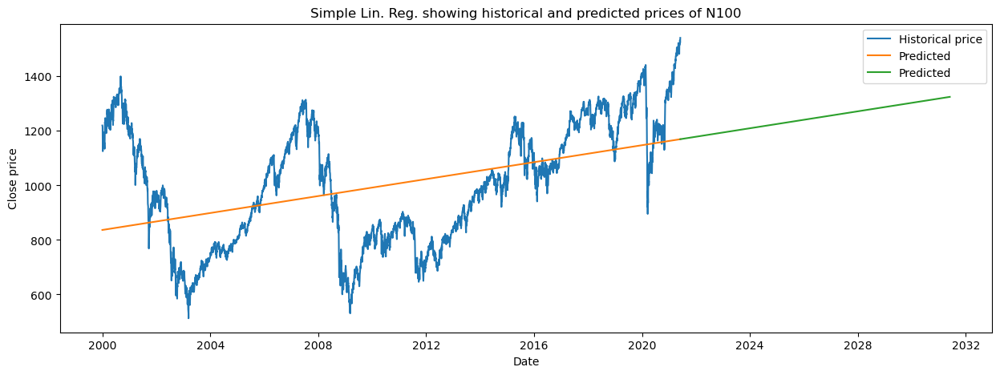

R-squared score N100 : 0.18892847523792788
Accuracy score N100 : 0.18892847523792788


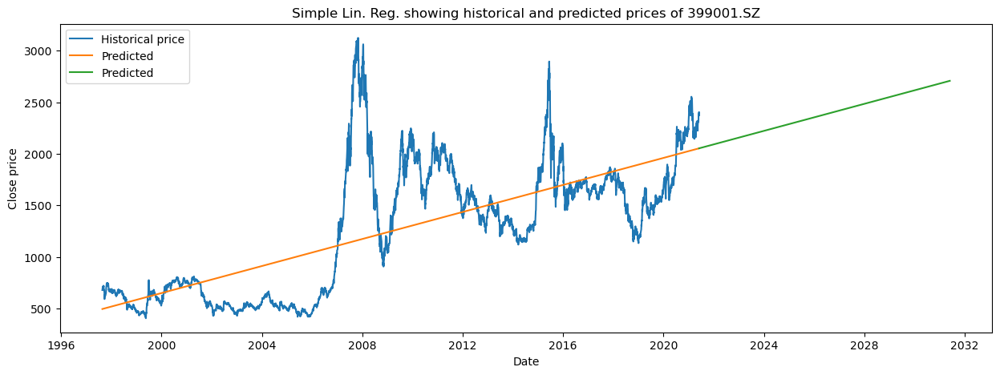

R-squared score 399001.SZ : 0.5027768325832862
Accuracy score 399001.SZ : 0.5027768325832862


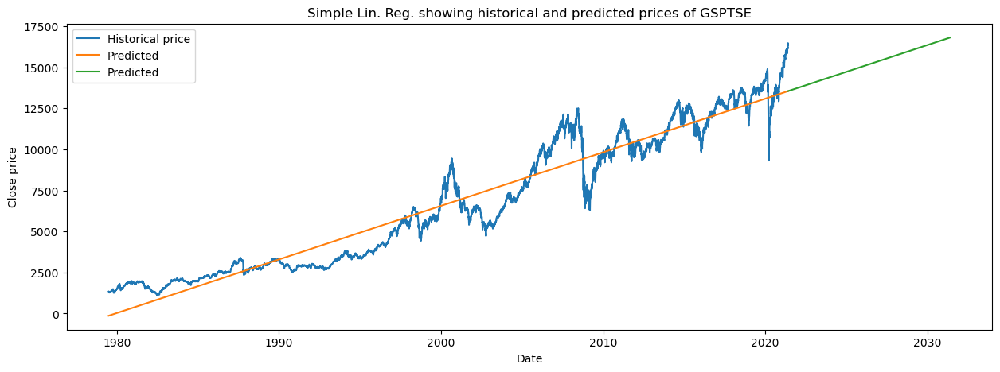

R-squared score GSPTSE : 0.9300651883218196
Accuracy score GSPTSE : 0.9300651883218196


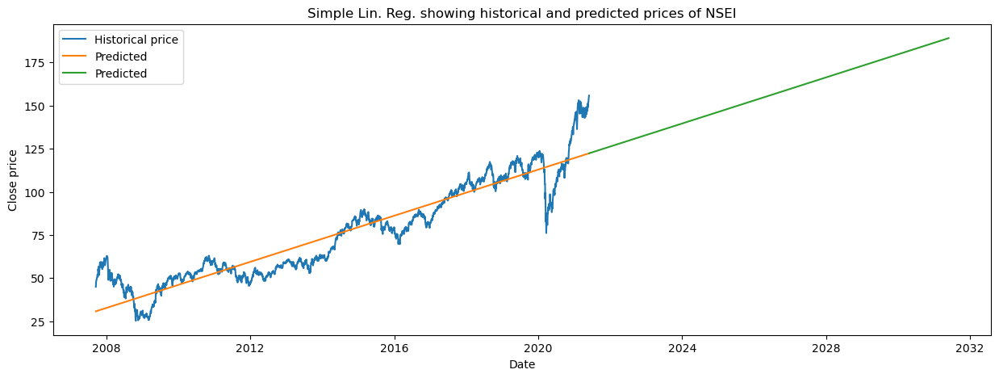

R-squared score NSEI : 0.8716677070743957
Accuracy score NSEI : 0.8716677070743957


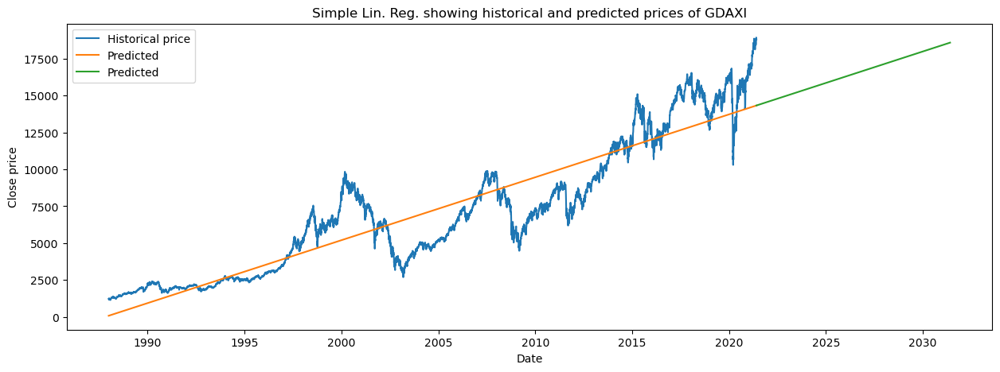

R-squared score GDAXI : 0.8502465344051668
Accuracy score GDAXI : 0.8502465344051668


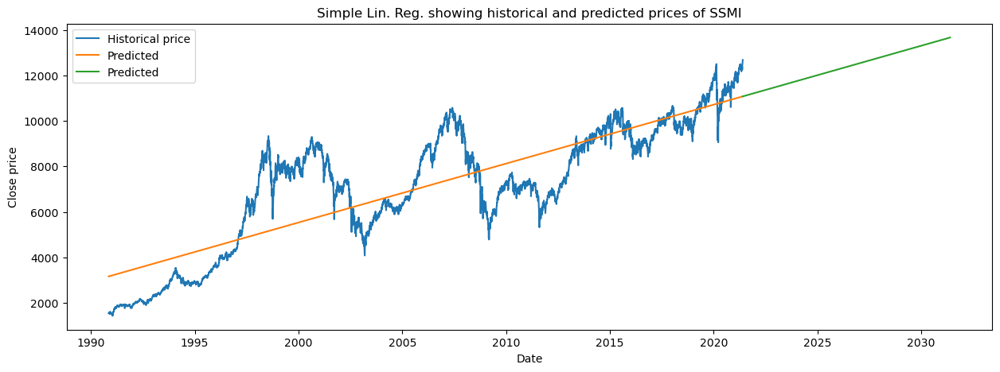

R-squared score SSMI : 0.7090852199974449
Accuracy score SSMI : 0.7090852199974449


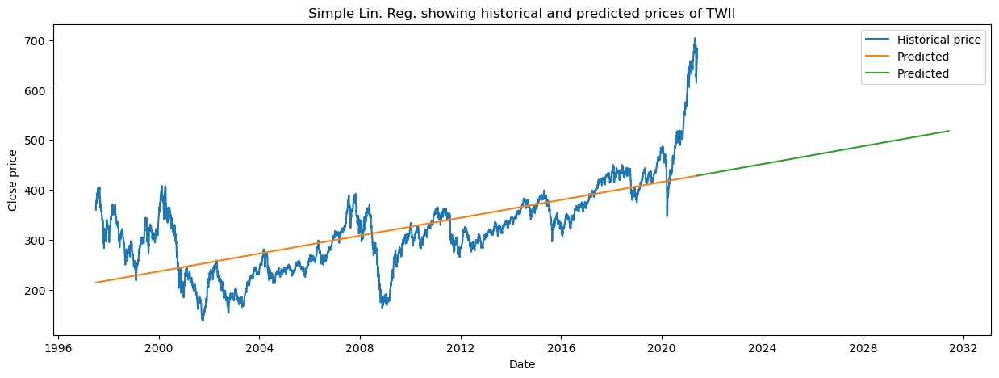

R-squared score TWII : 0.4825164035040662
Accuracy score TWII : 0.4825164035040662


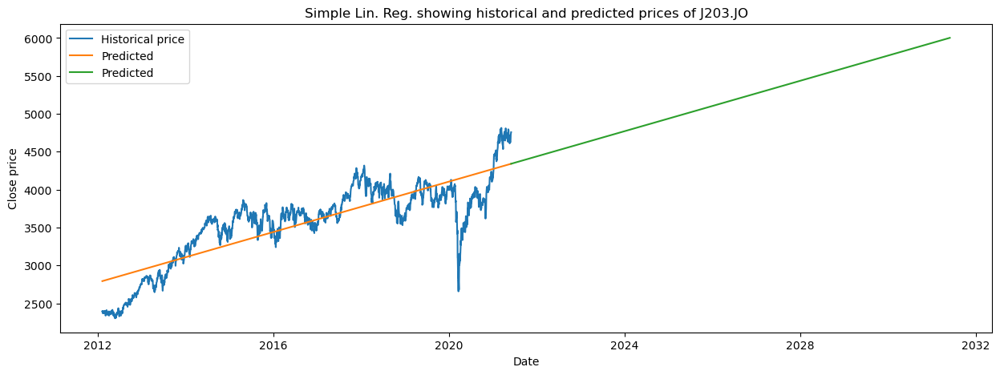

R-squared score J203.JO : 0.704265975352504
Accuracy score J203.JO : 0.704265975352504


In [45]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
import matplotlib.pyplot as plt

class DataPreparation:
    def __init__(self, df, stcexch):
        self.df = df
        self.stcexch = stcexch
        self.prepare_data()

    def prepare_data(self):
        dfcopy = self.df.copy()
        dfcopy_nya = dfcopy.loc[dfcopy.Index == self.stcexch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)

class LinearModel(DataPreparation):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.train_model()

    def train_model(self):
        self.lr = LinearRegression().fit(self.X.reshape(-1,1), self.y)
        self.score = self.lr.score(self.X.reshape(-1,1), self.y)
        self.y_pred = self.lr.predict(self.X.reshape(-1,1))

class FuturePredictions(LinearModel):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.predict_future()

    def predict_future(self):
        newdate = np.asarray(pd.RangeIndex(start=self.X[-1], stop=self.X[-1] + 3650))
        self.y_newdate_pred = self.lr.predict(newdate.reshape(-1,1))
        self.x_future_date = pd.to_datetime(newdate, origin='1970-01-01', unit='D')

class Plotting(FuturePredictions):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.plot_data()

    def plot_data(self):
        x_date = pd.to_datetime(self.X, origin='1970-01-01', unit='D')
        plt.figure(figsize=(15,5))
        plt.plot(self.X, self.y, label='Historical price')
        plt.plot(x_date, self.y_pred, label='Predicted')
        plt.plot(self.x_future_date, self.y_newdate_pred, label='Predicted')
        plt.xlabel('Date')
        plt.ylabel('Close price')
        plt.title('Simple Lin. Reg. showing historical and predicted prices of ' + self.stcexch)
        plt.legend()
        plt.show()
        print('R-squared score',(self.stcexch),':', self.score)
        print('Accuracy score',(self.stcexch),':', self.lr.score(self.X.reshape(-1,1), self.y))

    def score(self):
        return self.score

for exch in df.Index.unique():
    plot = Plotting(df, exch)
    # print('R-squared score',(exch),':', plot.score())

### Polyonomial Regression

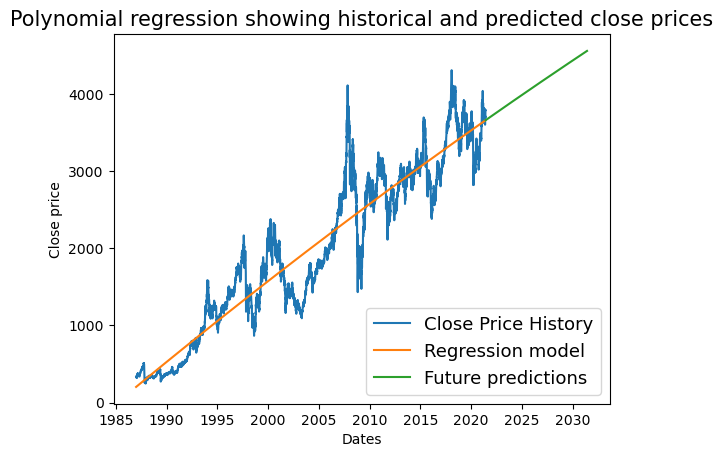

R-squared score HSI : 0.8935193973952426
MAE2 degree polynomial: 264.0899265986133
RMSE2 degree polynomial: 16.25084387343049
Accuracy 2 degree polynomial: 0.8935193973952426


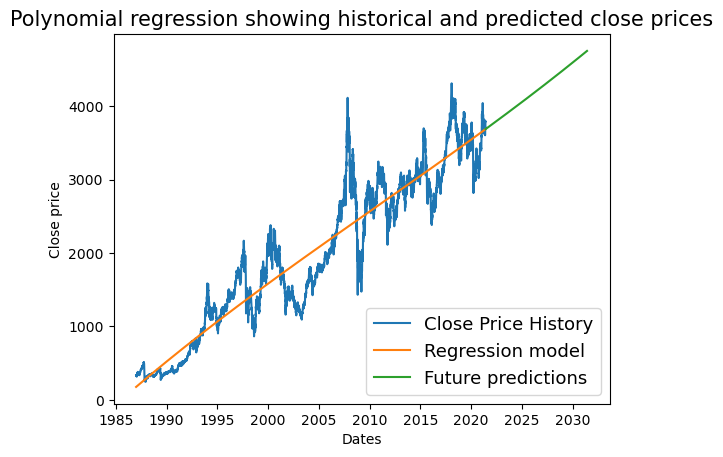

R-squared score HSI : 0.8936025527869864
MAE3 degree polynomial: 263.54679719916237
RMSE3 degree polynomial: 16.234124466664728
Accuracy 3 degree polynomial: 0.8936025527869864


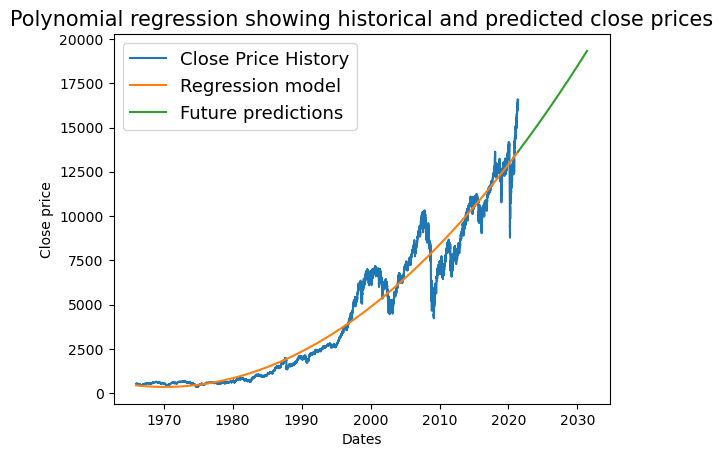

R-squared score NYA : 0.9551366290632846
MAE2 degree polynomial: 602.4639829814435
RMSE2 degree polynomial: 24.545141738874587
Accuracy 2 degree polynomial: 0.9551366290632846


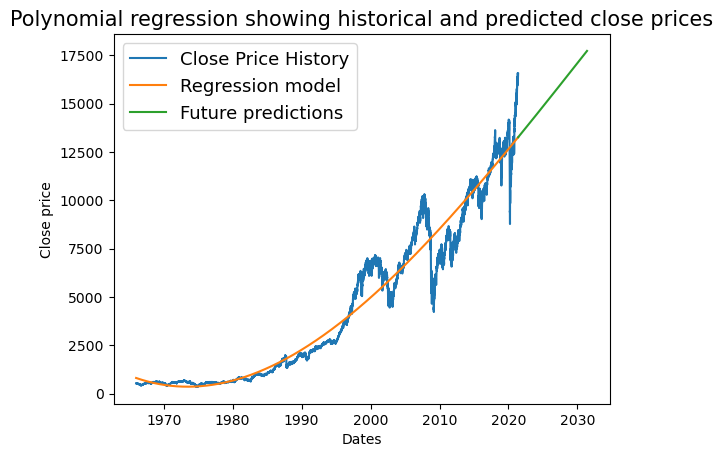

R-squared score NYA : 0.9563392994966855
MAE3 degree polynomial: 570.8599669265891
RMSE3 degree polynomial: 23.892676010162383
Accuracy 3 degree polynomial: 0.9563392994966855


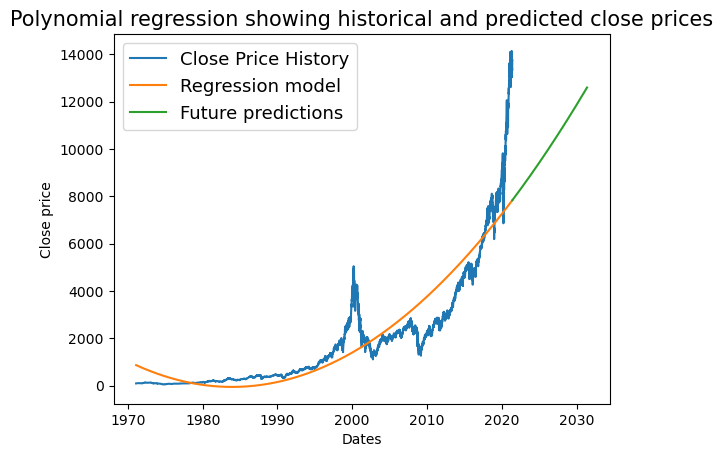

R-squared score IXIC : 0.8303706160454534
MAE2 degree polynomial: 663.5497020028994
RMSE2 degree polynomial: 25.75945849591756
Accuracy 2 degree polynomial: 0.8303706160454534


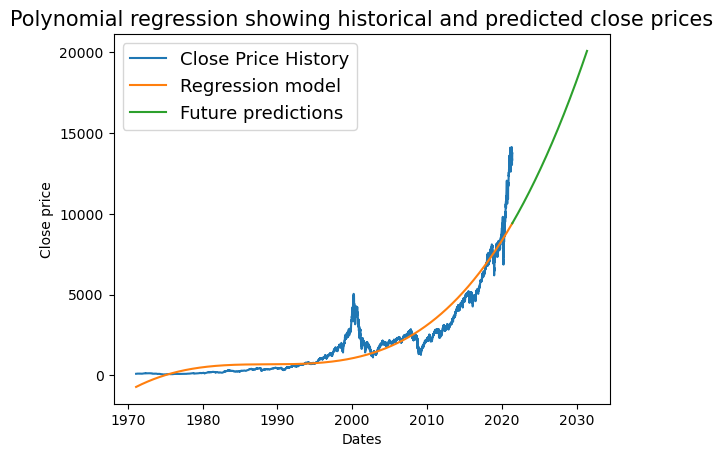

R-squared score IXIC : 0.8883169693727881
MAE3 degree polynomial: 545.896572627571
RMSE3 degree polynomial: 23.364429644816305
Accuracy 3 degree polynomial: 0.8883169693727881


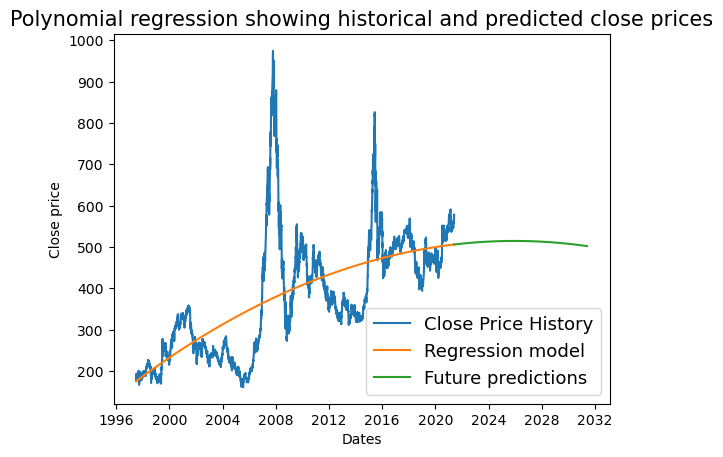

R-squared score 000001.SS : 0.44008128622472453
MAE2 degree polynomial: 74.94961443454874
RMSE2 degree polynomial: 8.657344537128504
Accuracy 2 degree polynomial: 0.44008128622472453


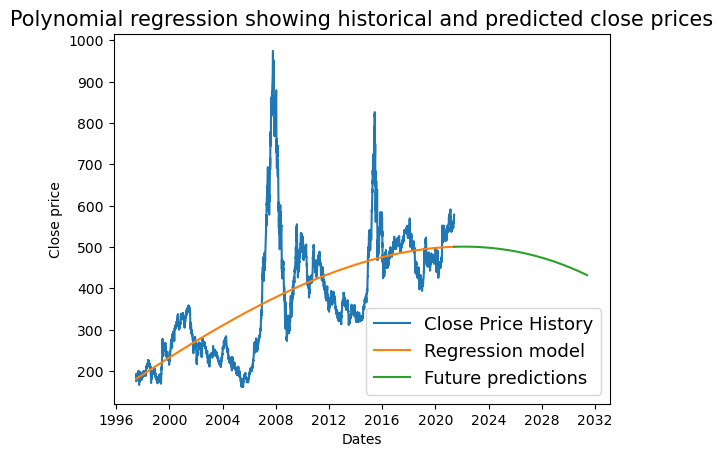

R-squared score 000001.SS : 0.44028441107202854
MAE3 degree polynomial: 74.70934633358213
RMSE3 degree polynomial: 8.643456850912264
Accuracy 3 degree polynomial: 0.44028441107202854


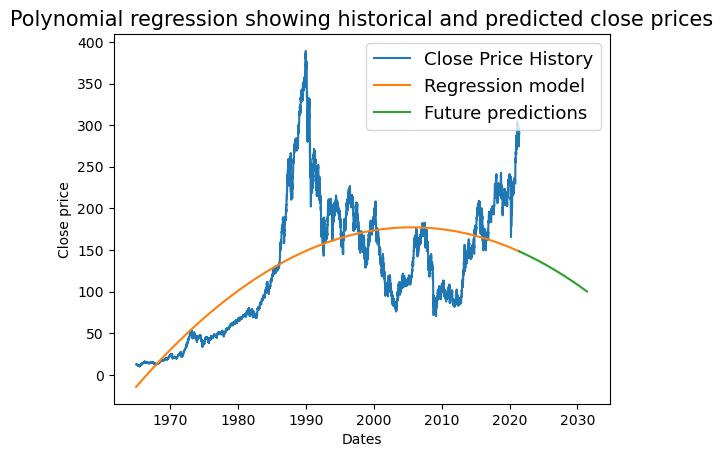

R-squared score N225 : 0.46021968578404393
MAE2 degree polynomial: 43.597500277345574
RMSE2 degree polynomial: 6.602840318934388
Accuracy 2 degree polynomial: 0.46021968578404393


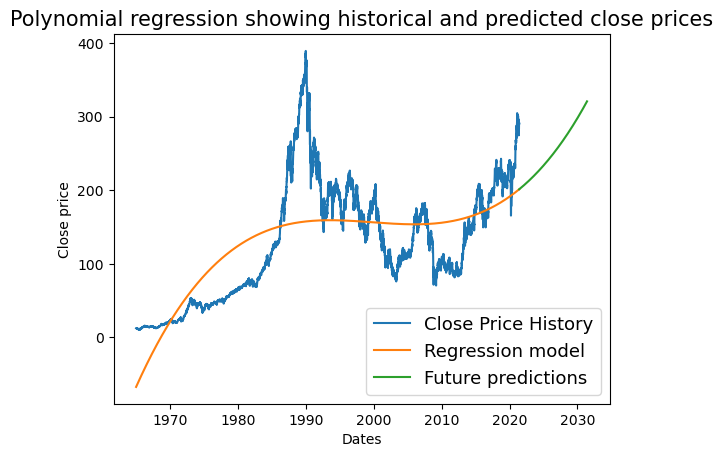

R-squared score N225 : 0.5216745532181251
MAE3 degree polynomial: 43.76441152102603
RMSE3 degree polynomial: 6.6154675965517376
Accuracy 3 degree polynomial: 0.5216745532181251


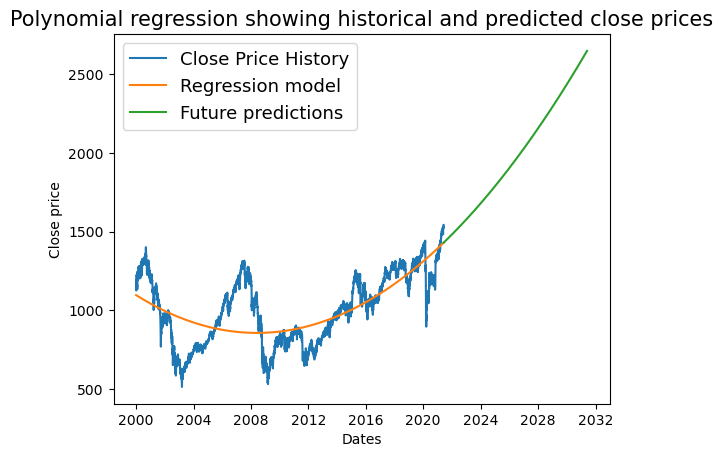

R-squared score N100 : 0.4637741675672541
MAE2 degree polynomial: 126.21451228283743
RMSE2 degree polynomial: 11.234523233445977
Accuracy 2 degree polynomial: 0.4637741675672541


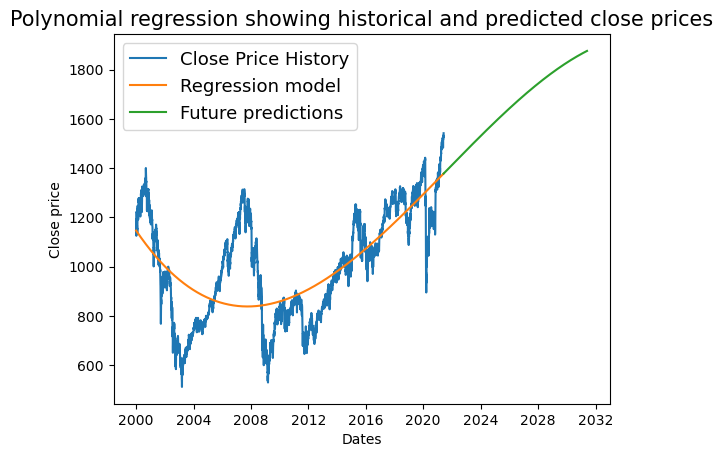

R-squared score N100 : 0.4713810994411698
MAE3 degree polynomial: 123.96237507244678
RMSE3 degree polynomial: 11.133839188368349
Accuracy 3 degree polynomial: 0.4713810994411698


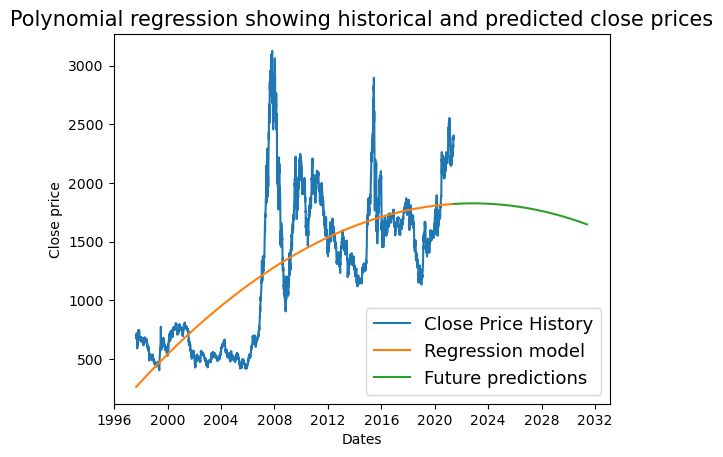

R-squared score 399001.SZ : 0.5294969629783997
MAE2 degree polynomial: 331.72004347747634
RMSE2 degree polynomial: 18.213183232962773
Accuracy 2 degree polynomial: 0.5294969629783997


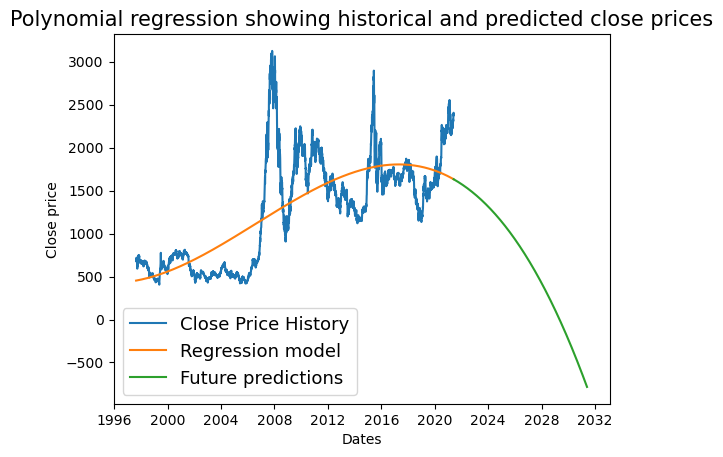

R-squared score 399001.SZ : 0.5422936168113884
MAE3 degree polynomial: 321.5971475277405
RMSE3 degree polynomial: 17.93312988654631
Accuracy 3 degree polynomial: 0.5422936168113884


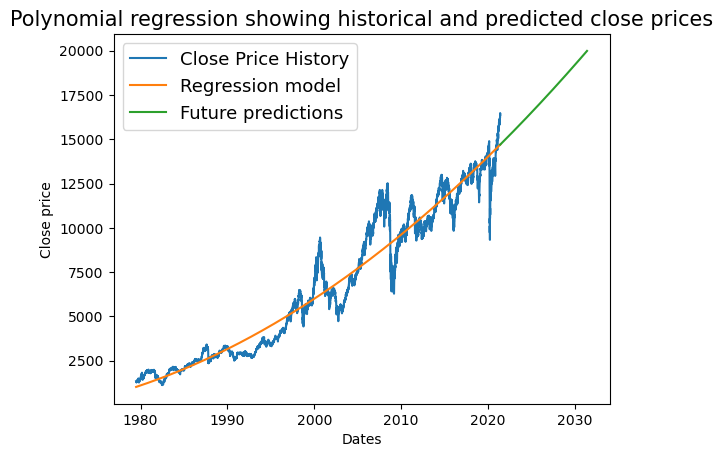

R-squared score GSPTSE : 0.945710430391278
MAE2 degree polynomial: 682.5906732592274
RMSE2 degree polynomial: 26.126436290838203
Accuracy 2 degree polynomial: 0.945710430391278


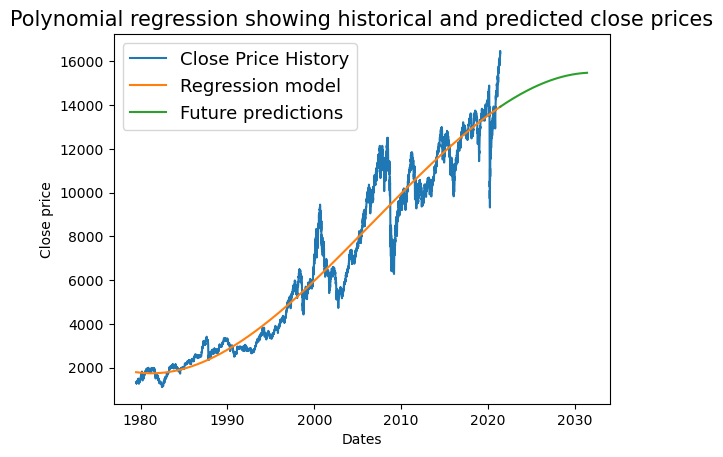

R-squared score GSPTSE : 0.9508060192405717
MAE3 degree polynomial: 659.2006265723479
RMSE3 degree polynomial: 25.674902659452243
Accuracy 3 degree polynomial: 0.9508060192405717


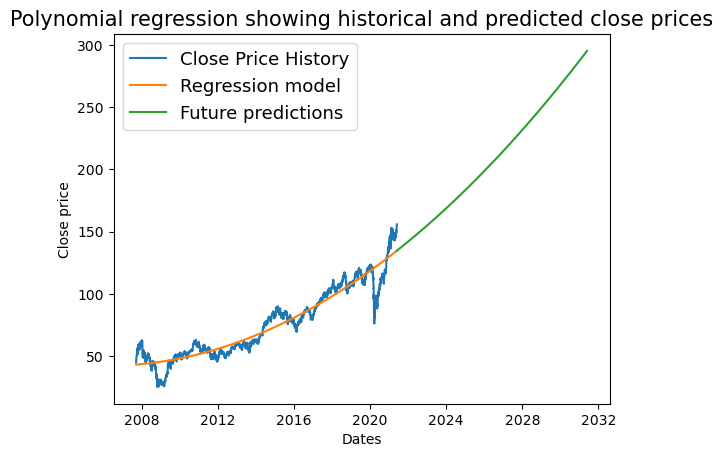

R-squared score NSEI : 0.90999504773411
MAE2 degree polynomial: 6.3311831070504505
RMSE2 degree polynomial: 2.516184235514254
Accuracy 2 degree polynomial: 0.90999504773411


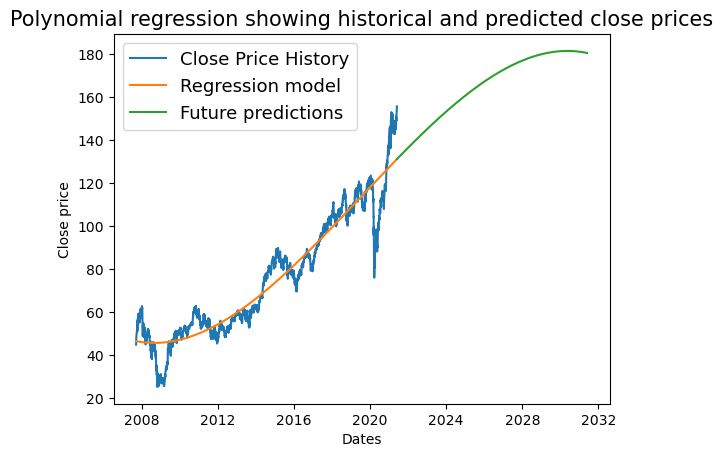

R-squared score NSEI : 0.9120941846677182
MAE3 degree polynomial: 6.173534151314559
RMSE3 degree polynomial: 2.4846597657052683
Accuracy 3 degree polynomial: 0.9120941846677182


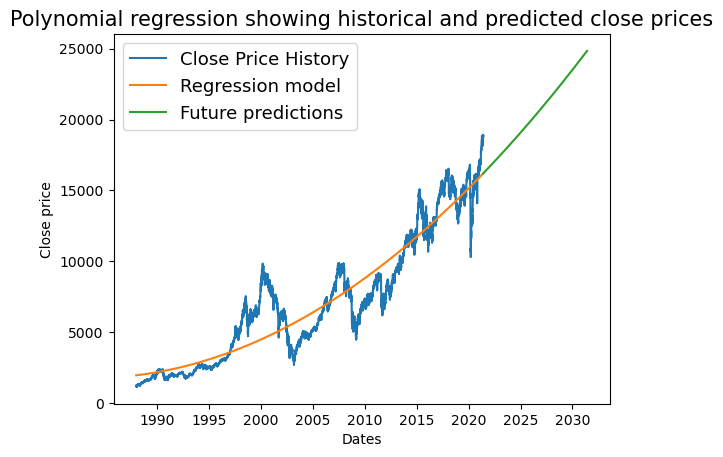

R-squared score GDAXI : 0.8858208951437128
MAE2 degree polynomial: 1159.5348285115313
RMSE2 degree polynomial: 34.051943094506825
Accuracy 2 degree polynomial: 0.8858208951437128


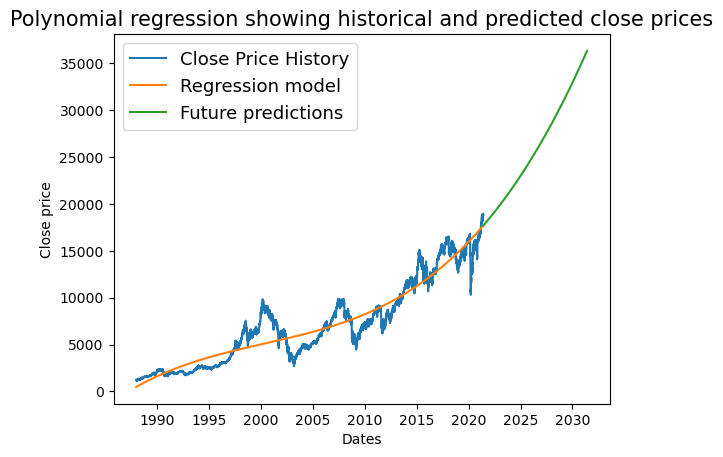

R-squared score GDAXI : 0.9013365642673523
MAE3 degree polynomial: 1122.5014000551896
RMSE3 degree polynomial: 33.50375202951439
Accuracy 3 degree polynomial: 0.9013365642673523


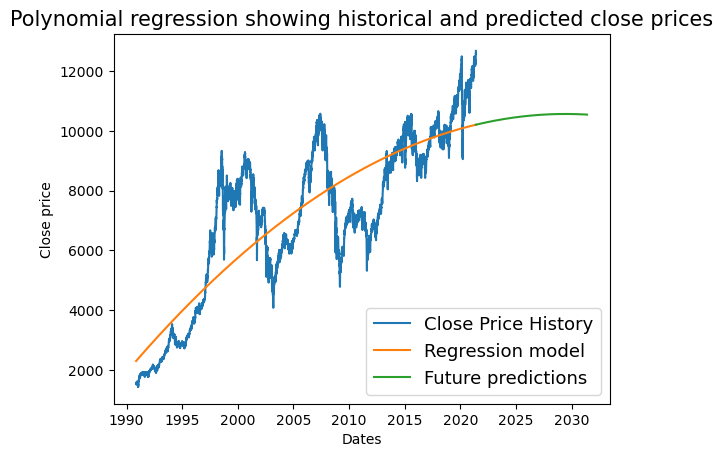

R-squared score SSMI : 0.7292965690410139
MAE2 degree polynomial: 1158.4152914856552
RMSE2 degree polynomial: 34.03550045886875
Accuracy 2 degree polynomial: 0.7292965690410139


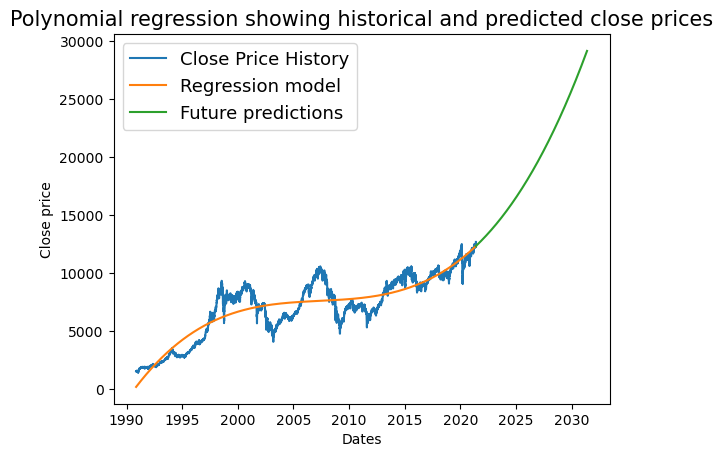

R-squared score SSMI : 0.8143591697113824
MAE3 degree polynomial: 960.3458979856797
RMSE3 degree polynomial: 30.98944817168708
Accuracy 3 degree polynomial: 0.8143591697113824


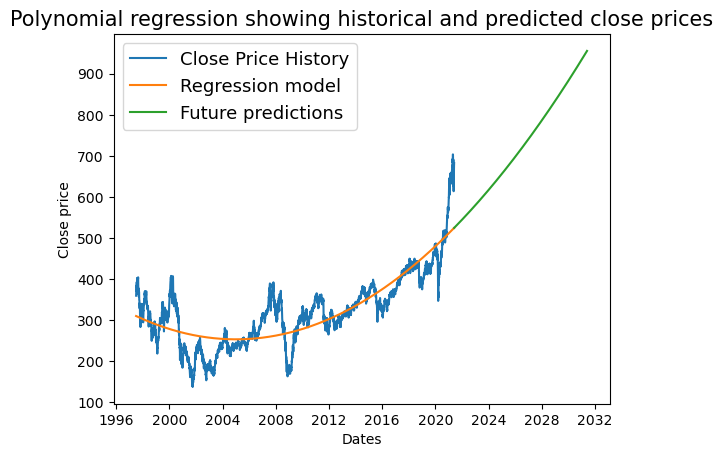

R-squared score TWII : 0.7154791179079554
MAE2 degree polynomial: 35.87169971763163
RMSE2 degree polynomial: 5.989298766769915
Accuracy 2 degree polynomial: 0.7154791179079554


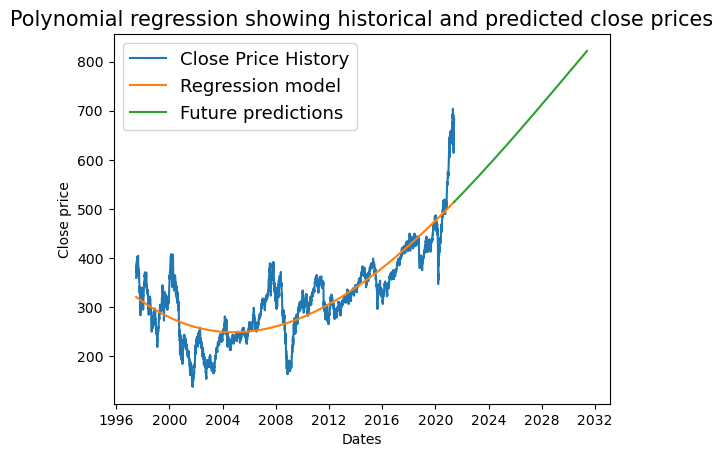

R-squared score TWII : 0.717483806006433
MAE3 degree polynomial: 35.40760799143756
RMSE3 degree polynomial: 5.950429227495909
Accuracy 3 degree polynomial: 0.717483806006433


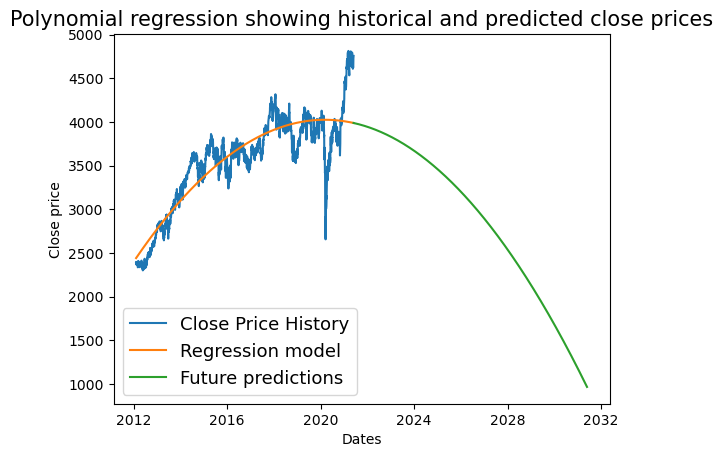

R-squared score J203.JO : 0.7910537822692352
MAE2 degree polynomial: 174.8534178983428
RMSE2 degree polynomial: 13.223215112004448
Accuracy 2 degree polynomial: 0.7910537822692352


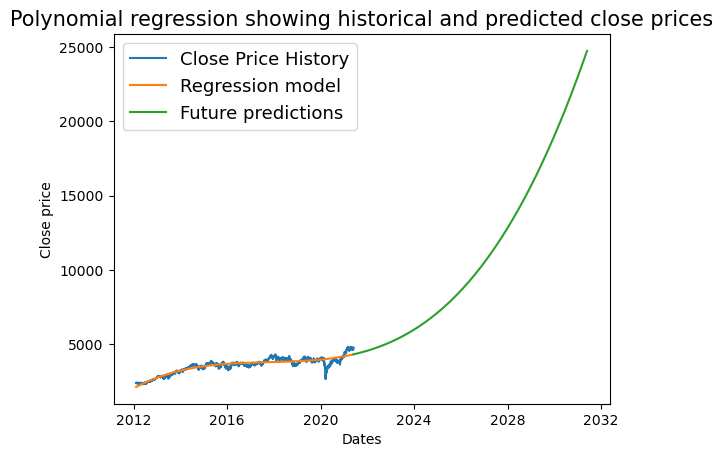

R-squared score J203.JO : 0.8442204051671383
MAE3 degree polynomial: 151.31689086225654
RMSE3 degree polynomial: 12.30109307591226
Accuracy 3 degree polynomial: 0.8442204051671383


In [73]:
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
import matplotlib.pyplot as plt

class DataPreparation:
    def __init__(self, df, stcexch, degree):
        self.df = df
        self.stcexch = stcexch
        self.degree = degree
        self.prepare_data()

    def prepare_data(self):
        dfcopy = self.df.copy()
        dfcopy_nya = dfcopy.loc[dfcopy.Index == self.stcexch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)

class PolynomialModel(DataPreparation):
    def __init__(self, df, stcexch, degree):
        super().__init__(df, stcexch, degree)
        self.train_model()

    def train_model(self):
        self.poly = PolynomialFeatures(degree=self.degree)
        self.X_transform = self.poly.fit_transform(self.X.reshape(-1,1))
        self.model = LinearRegression()
        self.model.fit(self.X_transform, self.y.reshape(-1,1))
        self.y_pred = self.model.predict(self.X_transform)

class FuturePredictions(PolynomialModel):
    def __init__(self, df, stcexch, degree):
        super().__init__(df, stcexch, degree)
        self.predict_future()

    def predict_future(self):
        newdate = np.asarray(pd.RangeIndex(start=self.X[-1], stop=self.X[-1] + 3650))
        self.X_newdate = self.poly.fit_transform(newdate.reshape(-1,1))
        self.y_newdate_pred = self.model.predict(self.X_newdate)
        self.x_future_date = pd.to_datetime(newdate, origin='1970-01-01', unit='D')

class Plotting(FuturePredictions):
    def __init__(self, df, stcexch, degree):
        super().__init__(df, stcexch, degree)
        self.plot_data()

    def plot_data(self):
        x_date = pd.to_datetime(self.X, origin='1970-01-01', unit='D')
        plt.plot(self.X, self.y, label='Close Price History')
        plt.plot(x_date, self.y_pred, label='Regression model')
        plt.plot(self.x_future_date, self.y_newdate_pred, label='Future predictions')
        plt.xlabel('Dates')
        plt.ylabel('Close price')
        plt.title('Polynomial regression showing historical and predicted close prices', fontsize=15)
        plt.legend(fontsize=13, loc='best')
        plt.show()
        print('R-squared score', (self.stcexch),':', self.model.score(self.X_transform, self.y.reshape(-1,1)))
        print('MAE' + str(self.degree) + ' degree polynomial:', mean_absolute_error(self.y, self.y_pred))
        print('RMSE' + str(self.degree) + ' degree polynomial:', np.sqrt(mean_absolute_error(self.y, self.y_pred))) 
        print('Accuracy ' + str(self.degree) + ' degree polynomial:', self.model.score(self.X_transform, self.y.reshape(-1,1))) 

for exch in df.Index.unique():
    plot = Plotting(df, exch, 2)
    plot1= Plotting(df, exch, 3)

### Laso Regression

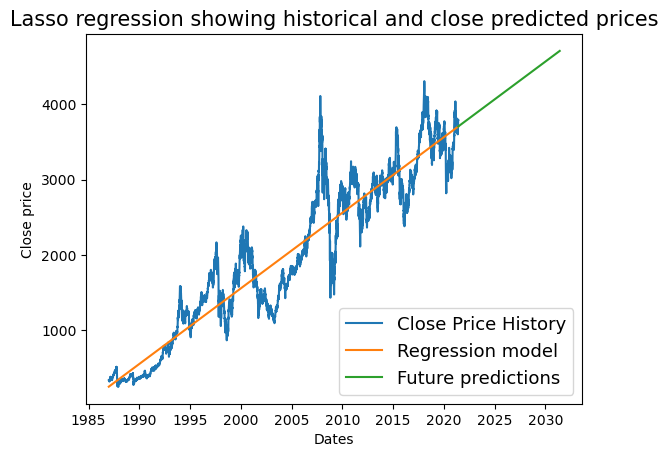

R-squared score HSI : 0.8931274509759525
MAE HSI : 265.8706801885713
RMSE HSI : 16.30554139513838
Accuracy score HSI : 0.8931274509759525
Best parameters for HSI: {'alpha': 1e-05, 'max_iter': 1000}


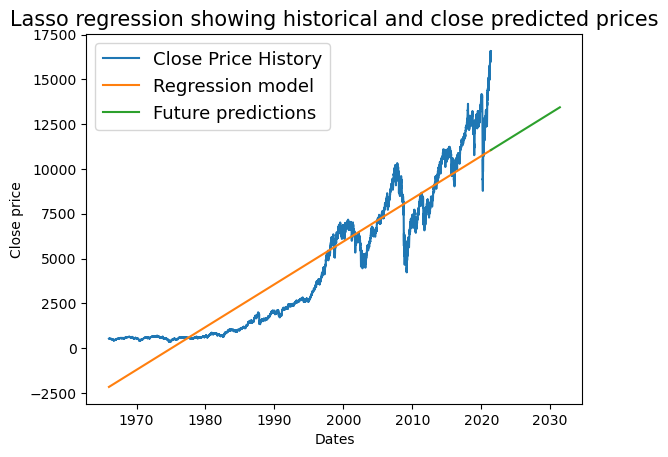

R-squared score NYA : 0.8747463684936102
MAE NYA : 1223.9394906809034
RMSE NYA : 34.984846586499465
Accuracy score NYA : 0.8747463684936102
Best parameters for NYA: {'alpha': 100, 'max_iter': 1000}


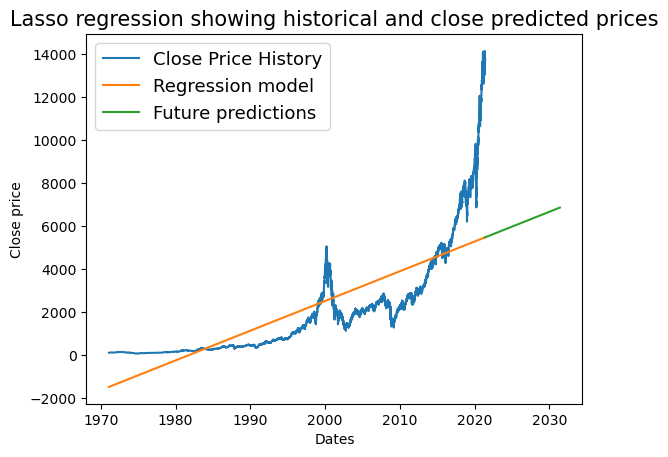

R-squared score IXIC : 0.6501269544901096
MAE IXIC : 1038.1704125687554
RMSE IXIC : 32.22065195753735
Accuracy score IXIC : 0.6501269544901096
Best parameters for IXIC: {'alpha': 100, 'max_iter': 1000}


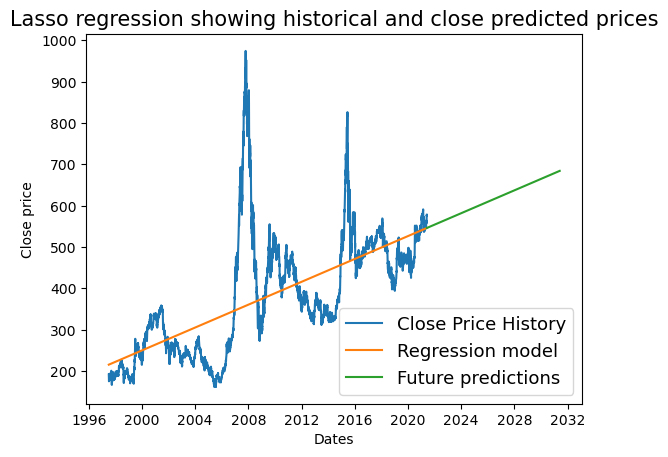

R-squared score 000001.SS : 0.4251332570629762
MAE 000001.SS : 75.03794989547137
RMSE 000001.SS : 8.662444798985526
Accuracy score 000001.SS : 0.4251332570629762
Best parameters for 000001.SS: {'alpha': 100, 'max_iter': 1000}


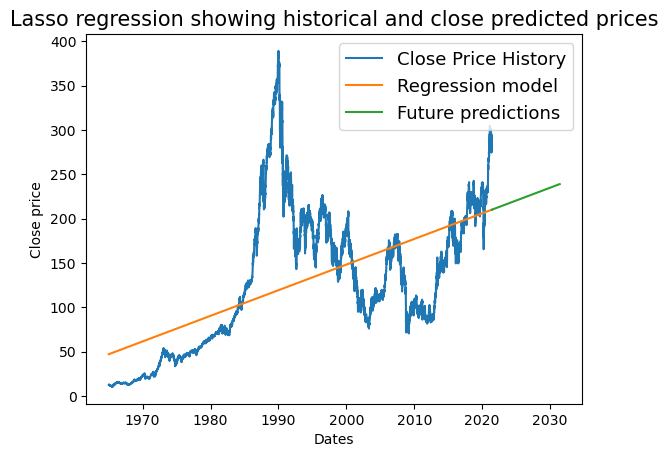

R-squared score N225 : 0.34260595616665335
MAE N225 : 48.615840701503274
RMSE N225 : 6.9725060560391965
Accuracy score N225 : 0.34260595616665335
Best parameters for N225: {'alpha': 1e-05, 'max_iter': 1000}


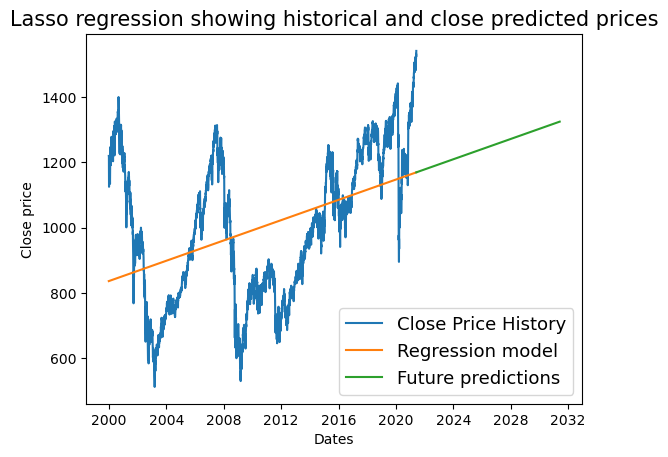

R-squared score N100 : 0.18892847523792788
MAE N100 : 167.225998558373
RMSE N100 : 12.93158917373936
Accuracy score N100 : 0.18892847523792788
Best parameters for N100: {'alpha': 1e-05, 'max_iter': 1000}


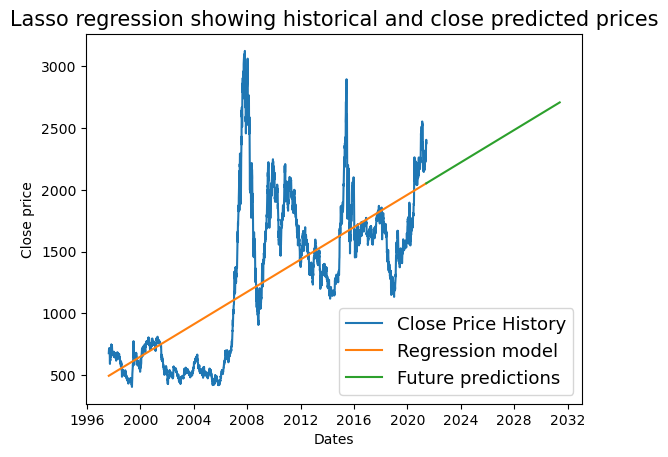

R-squared score 399001.SZ : 0.5027768325832862
MAE 399001.SZ : 327.45066979142905
RMSE 399001.SZ : 18.095598077748882
Accuracy score 399001.SZ : 0.5027768325832862
Best parameters for 399001.SZ: {'alpha': 1e-05, 'max_iter': 1000}


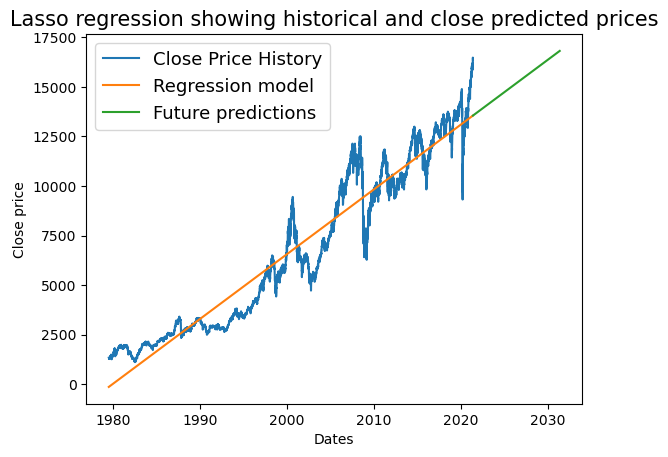

R-squared score GSPTSE : 0.9300651882911632
MAE GSPTSE : 888.6715095972127
RMSE GSPTSE : 29.8105939155397
Accuracy score GSPTSE : 0.9300651882911632
Best parameters for GSPTSE: {'alpha': 100, 'max_iter': 1000}


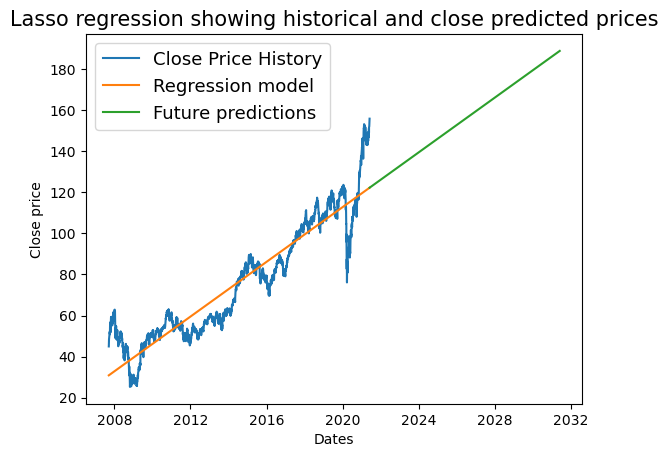

R-squared score NSEI : 0.871661750566806
MAE NSEI : 7.830071646242731
RMSE NSEI : 2.79822651803651
Accuracy score NSEI : 0.871661750566806
Best parameters for NSEI: {'alpha': 100, 'max_iter': 1000}


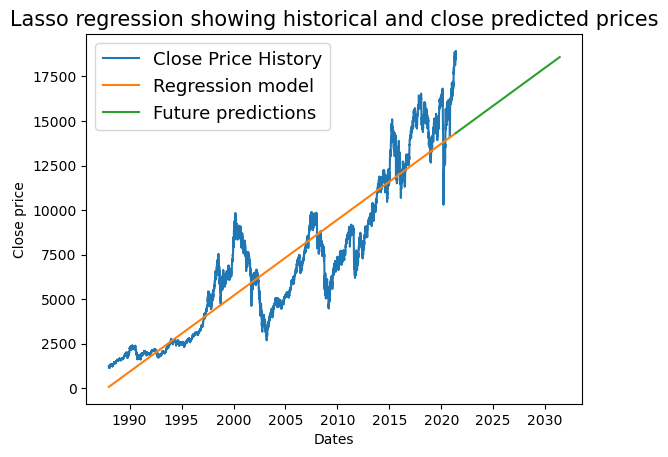

R-squared score GDAXI : 0.8502465343643509
MAE GDAXI : 1385.6515162332946
RMSE GDAXI : 37.22434037338062
Accuracy score GDAXI : 0.8502465343643509
Best parameters for GDAXI: {'alpha': 100, 'max_iter': 1000}


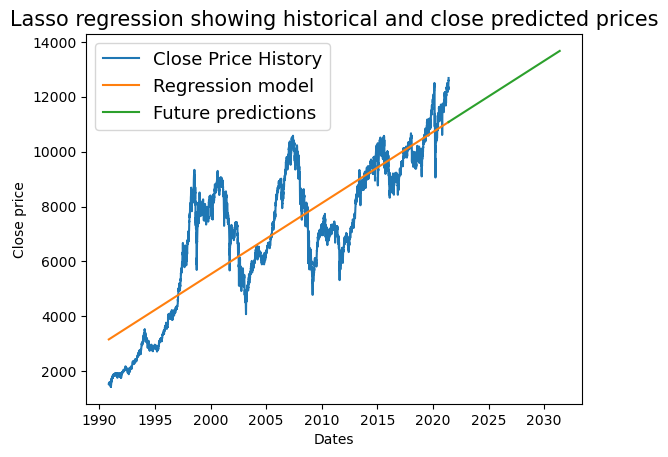

R-squared score SSMI : 0.7090852199974449
MAE SSMI : 1196.998171661716
RMSE SSMI : 34.59766136116307
Accuracy score SSMI : 0.7090852199974449
Best parameters for SSMI: {'alpha': 1e-05, 'max_iter': 1000}


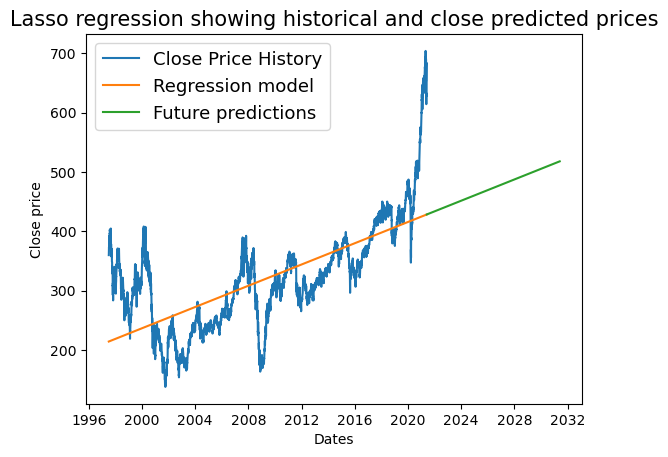

R-squared score TWII : 0.4825162024718407
MAE TWII : 48.16087479432874
RMSE TWII : 6.939803656756345
Accuracy score TWII : 0.4825162024718407
Best parameters for TWII: {'alpha': 100, 'max_iter': 1000}


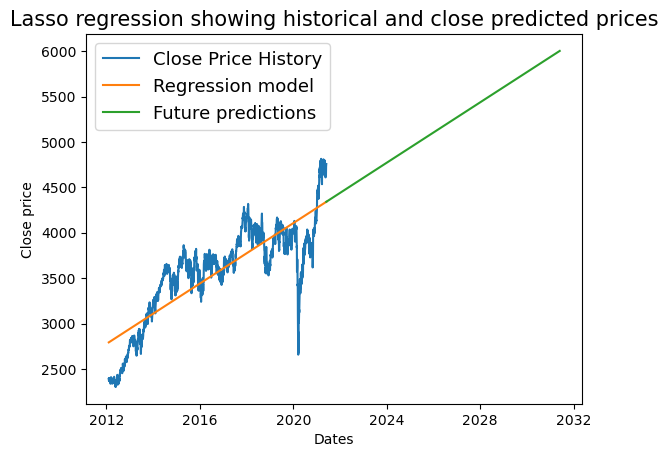

R-squared score J203.JO : 0.704265975352504
MAE J203.JO : 233.15333640624178
RMSE J203.JO : 15.26935939737623
Accuracy score J203.JO : 0.704265975352504
Best parameters for J203.JO: {'alpha': 1e-05, 'max_iter': 1000}


In [66]:
import numpy as np
import pandas as pd
from sklearn.linear_model import Lasso
import matplotlib.pyplot as plt

class DataPreparation:
    def __init__(self, df, stcexch):
        self.df = df
        self.stcexch = stcexch
        self.prepare_data()

    def prepare_data(self):
        dfcopy = self.df.copy()
        dfcopy_nya = dfcopy.loc[dfcopy.Index == self.stcexch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)

from sklearn.model_selection import GridSearchCV

class LassoModel(DataPreparation):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.train_model()

    def train_model(self):
        parameters = {'alpha': [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100], 'max_iter': [1000, 5000, 10000]}
        lasso = Lasso()
        self.clf = GridSearchCV(lasso, parameters)
        self.clf.fit(self.X.reshape(-1,1), self.y.reshape(-1,1))
        self.y_pred = self.clf.predict(self.X.reshape(-1,1))

    def get_best_params(self):
        return self.clf.best_params_
    
class FuturePredictions(LassoModel):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.predict_future()

    def predict_future(self):
        newdate = np.asarray(pd.RangeIndex(start=self.X[-1], stop=self.X[-1] + 3650))
        self.y_newdate_pred = self.clf.predict(newdate.reshape(-1,1))
        self.x_future_date = pd.to_datetime(newdate, origin='1970-01-01', unit='D')

class Plotting(FuturePredictions):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.plot_data()

    def plot_data(self):
        x_date = pd.to_datetime(self.X, origin='1970-01-01', unit='D')
        plt.plot(self.X, self.y, label='Close Price History')
        plt.plot(x_date, self.y_pred, label='Regression model')
        plt.plot(self.x_future_date, self.y_newdate_pred, label='Future predictions')
        plt.title('Lasso regression showing historical and close predicted prices', fontsize=15)
        plt.xlabel('Dates')
        plt.ylabel('Close price')
        plt.legend(fontsize=13, loc='best')
        plt.show()
        print('R-squared score',(self.stcexch),':', self.clf.score(self.X.reshape(-1,1), self.y.reshape(-1,1))) 
        print('MAE' ,(self.stcexch),':', mean_absolute_error(self.y, self.y_pred))
        print('RMSE',(self.stcexch),':', np.sqrt(mean_absolute_error(self.y, self.y_pred)))

        print('Accuracy score',(self.stcexch),':', self.clf.score(self.X.reshape(-1,1), self.y.reshape(-1,1)))

for exch in df.Index.unique():
    plot = Plotting(df, exch)
    print(f"Best parameters for {exch}: {plot.get_best_params()}")



### Ridge Regression

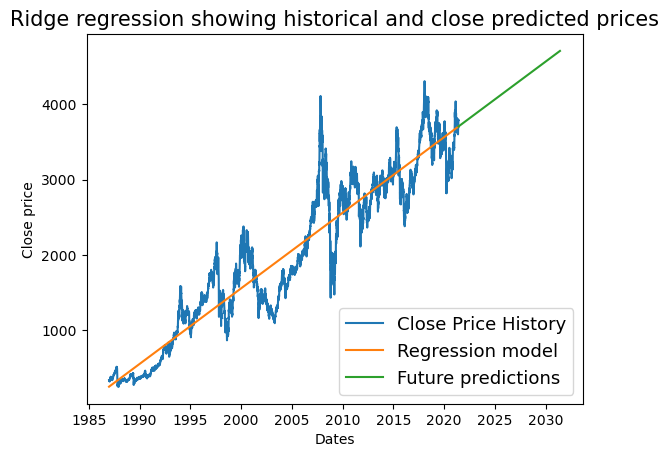

R-squared score HSI : 0.8931274509759525
MAEHSI : 265.87068018835413
RMSEHSI : 16.305541395131723
Accuracy score HSI : 0.8931274509759525
Best parameters for HSI: {'alpha': 1e-05, 'max_iter': 1000}


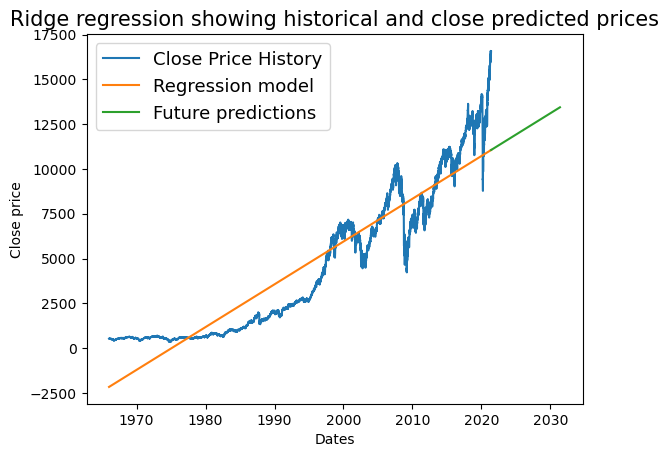

R-squared score NYA : 0.8747463685113148
MAENYA : 1223.9394923233738
RMSENYA : 34.984846609973495
Accuracy score NYA : 0.8747463685113148
Best parameters for NYA: {'alpha': 100, 'max_iter': 1000}


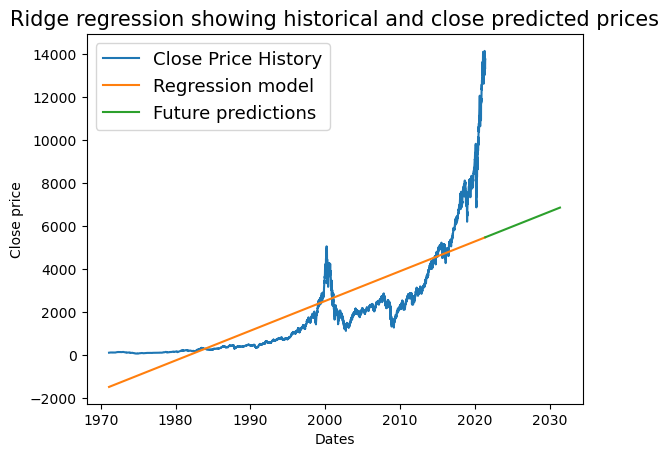

R-squared score IXIC : 0.6501269545473616
MAEIXIC : 1038.1752348552627
RMSEIXIC : 32.22072678968094
Accuracy score IXIC : 0.6501269545473616
Best parameters for IXIC: {'alpha': 100, 'max_iter': 1000}


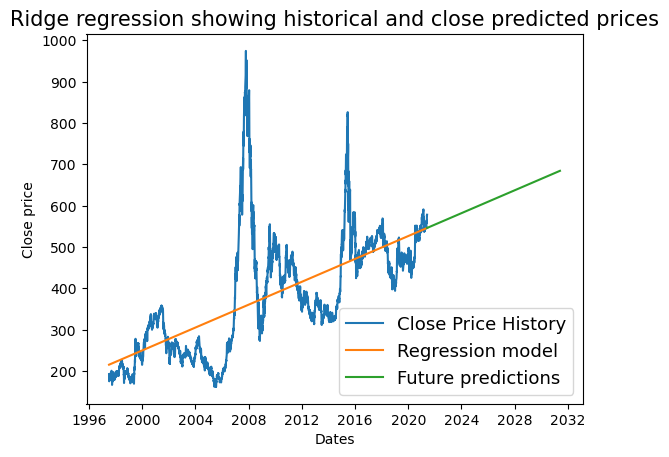

R-squared score 000001.SS : 0.4251333304983649
MAE000001.SS : 75.03298548281192
RMSE000001.SS : 8.662158246234707
Accuracy score 000001.SS : 0.4251333304983649
Best parameters for 000001.SS: {'alpha': 100, 'max_iter': 1000}


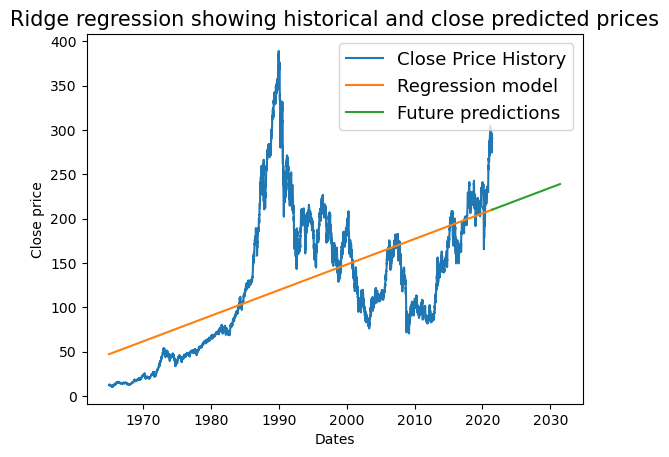

R-squared score N225 : 0.34260595616665335
MAEN225 : 48.61584070111618
RMSEN225 : 6.972506056011438
Accuracy score N225 : 0.34260595616665335
Best parameters for N225: {'alpha': 1e-05, 'max_iter': 1000}


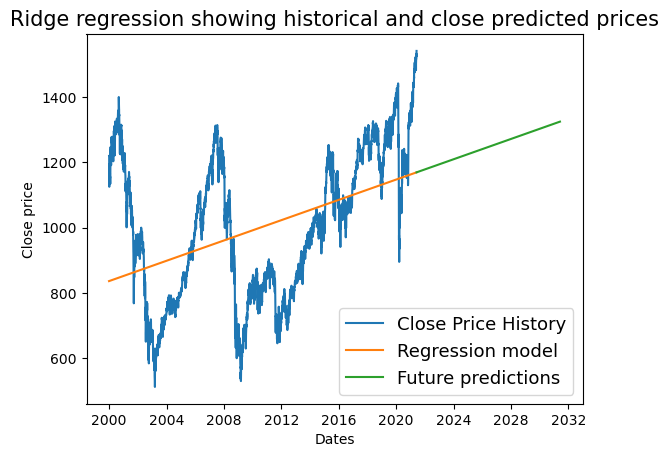

R-squared score N100 : 0.18892847523792788
MAEN100 : 167.22599859221032
RMSEN100 : 12.931589175047678
Accuracy score N100 : 0.18892847523792788
Best parameters for N100: {'alpha': 100, 'max_iter': 1000}


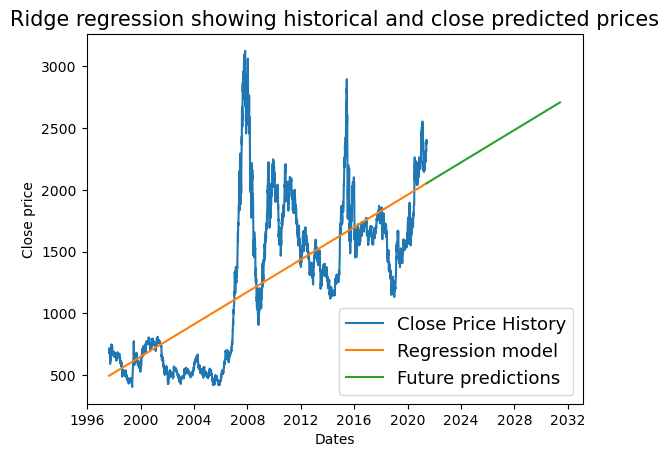

R-squared score 399001.SZ : 0.5027768325832862
MAE399001.SZ : 327.45066979172617
RMSE399001.SZ : 18.095598077757092
Accuracy score 399001.SZ : 0.5027768325832862
Best parameters for 399001.SZ: {'alpha': 0.0001, 'max_iter': 1000}


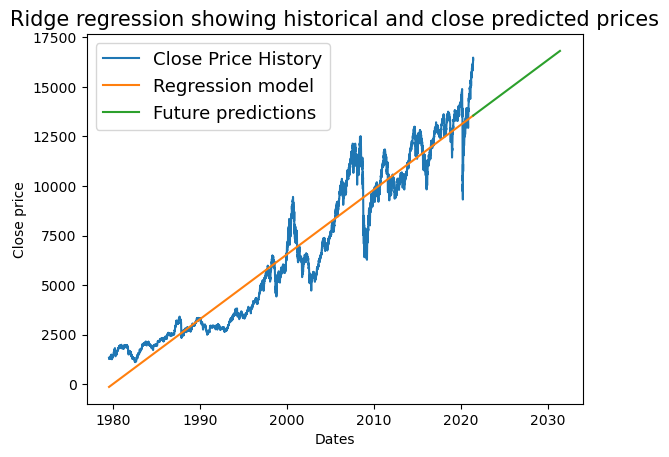

R-squared score GSPTSE : 0.9300651883218196
MAEGSPTSE : 888.6726480215256
RMSEGSPTSE : 29.810613009824632
Accuracy score GSPTSE : 0.9300651883218196
Best parameters for GSPTSE: {'alpha': 100, 'max_iter': 1000}


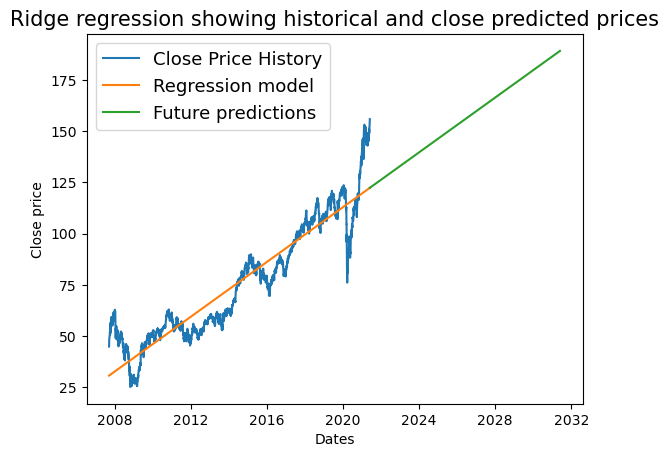

R-squared score NSEI : 0.8716677070743956
MAENSEI : 7.829683064650467
RMSENSEI : 2.7981570836267338
Accuracy score NSEI : 0.8716677070743956
Best parameters for NSEI: {'alpha': 100, 'max_iter': 1000}


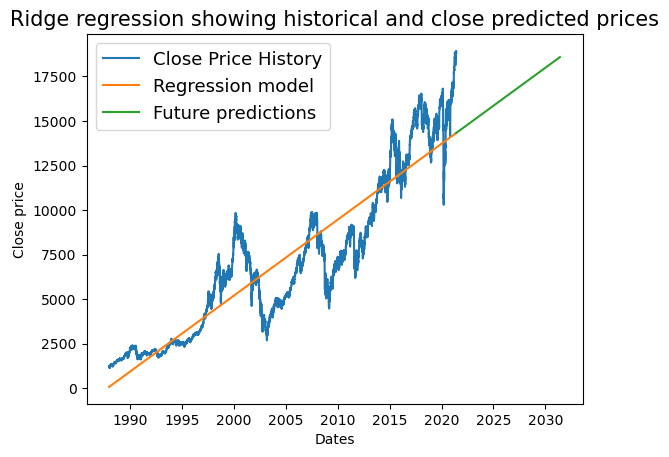

R-squared score GDAXI : 0.8502465344051668
MAEGDAXI : 1385.6519558505777
RMSEGDAXI : 37.224346278350914
Accuracy score GDAXI : 0.8502465344051668
Best parameters for GDAXI: {'alpha': 100, 'max_iter': 1000}


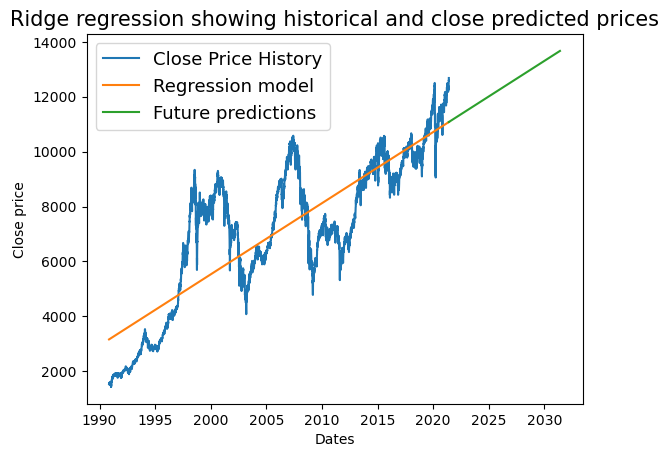

R-squared score SSMI : 0.7090852199974449
MAESSMI : 1196.9981716613327
RMSESSMI : 34.59766136115753
Accuracy score SSMI : 0.7090852199974449
Best parameters for SSMI: {'alpha': 1e-05, 'max_iter': 1000}


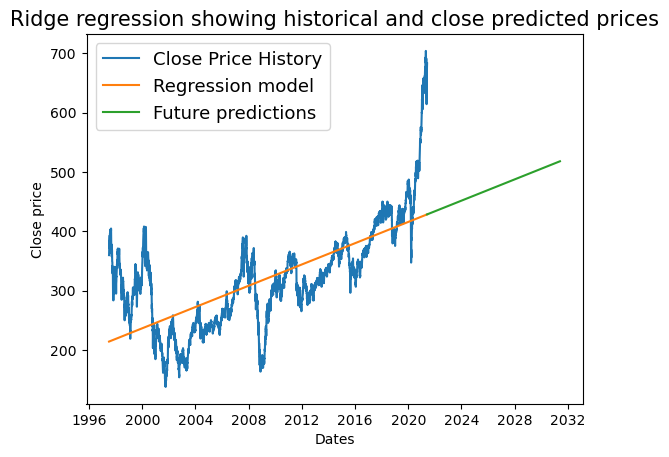

R-squared score TWII : 0.4825164035040662
MAETWII : 48.15838810927728
RMSETWII : 6.939624493391359
Accuracy score TWII : 0.4825164035040662
Best parameters for TWII: {'alpha': 100, 'max_iter': 1000}


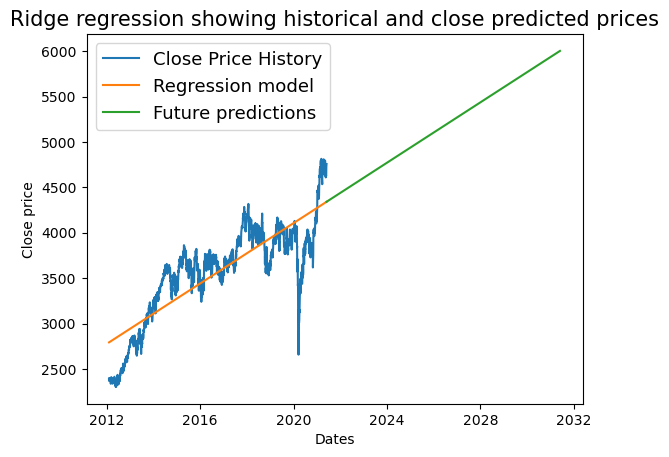

R-squared score J203.JO : 0.7042659753525027
MAEJ203.JO : 233.15333625060285
RMSEJ203.JO : 15.269359392279783
Accuracy score J203.JO : 0.7042659753525027
Best parameters for J203.JO: {'alpha': 100, 'max_iter': 1000}


In [67]:
import numpy as np
import pandas as pd
from sklearn.linear_model import Ridge
import matplotlib.pyplot as plt

class DataPreparation:
    def __init__(self, df, stcexch):
        self.df = df
        self.stcexch = stcexch
        self.prepare_data()

    def prepare_data(self):
        dfcopy = self.df.copy()
        dfcopy_nya = dfcopy.loc[dfcopy.Index == self.stcexch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)

class RidgeModel(DataPreparation):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.train_model()

    def train_model(self):
        parameters = {'alpha': [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100], 'max_iter': [1000, 5000, 10000]}
        ridge = Ridge()
        self.clf = GridSearchCV(ridge, parameters)
        self.clf.fit(self.X.reshape(-1,1), self.y.reshape(-1,1))
        self.y_pred = self.clf.predict(self.X.reshape(-1,1))

    def get_best_params(self):
        return self.clf.best_params_

class FuturePredictions(RidgeModel):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.predict_future()

    def predict_future(self):
        newdate = np.asarray(pd.RangeIndex(start=self.X[-1], stop=self.X[-1] + 3650))
        self.y_newdate_pred = self.clf.predict(newdate.reshape(-1,1))
        self.x_future_date = pd.to_datetime(newdate, origin='1970-01-01', unit='D')


class Plotting(FuturePredictions):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.plot_data()

    def plot_data(self):
        x_date = pd.to_datetime(self.X, origin='1970-01-01', unit='D')
        plt.plot(self.X, self.y, label='Close Price History')
        plt.plot(x_date, self.y_pred, label='Regression model')
        plt.plot(self.x_future_date, self.y_newdate_pred, label='Future predictions')
        plt.title('Ridge regression showing historical and close predicted prices', fontsize=15)
        plt.xlabel('Dates')
        plt.ylabel('Close price')
        plt.legend(fontsize=13, loc='best')
        plt.show()
        print('R-squared score',(self.stcexch),':', self.clf.score(self.X.reshape(-1,1), self.y.reshape(-1,1)))
        print('MAE' + (self.stcexch),':', mean_absolute_error(self.y.reshape(-1,1), self.y_pred.reshape(-1,1)))
        print ('RMSE' + (self.stcexch),':', np.sqrt(mean_absolute_error(self.y.reshape(-1,1), self.y_pred.reshape(-1,1))))
        
        print('Accuracy score',(self.stcexch),':', self.clf.score(self.X.reshape(-1,1), self.y.reshape(-1,1)))

for exch in df.Index.unique():
    plot = Plotting(df, exch)
    print(f"Best parameters for {exch}: {plot.get_best_params()}")

### K-Means

In [49]:
# Define hyper parameter ratios
def ratios(df,exch):
    # cumulative returns for each exchange
    data = df.copy()
    ratiodf = data.loc[data['Index']==exch]
    ratiodf['Daily returns'] = ratiodf['Close'].pct_change()
    ratiodf['Cumulative returns'] = (1 + ratiodf['Daily returns']).cumprod()
    
    trading_days = 252 # no. of trading days in a year
    n = len(data) /trading_days
    
    # calculate cumulative reurns
    # CAGR -> compound annual growth rate
    # CAGR = ((End_value / Beginning_value)**1/n  - 1 ) * 100
    cagr = ( ( ratiodf['Cumulative returns'][-1]**(1/n) ) - 1 ) * 100
    
    # calculate annualized volatility
    vol = ratiodf['Daily returns'].std() * np.sqrt(trading_days)
    
    
    return cagr, vol

In [50]:
# calculating CAGR and Volatility for each index and storing the result in a dataframe

c=[]; v=[]

for exch in df.Index.unique():
    cagr, vol = ratios(df,exch)
    c.append(cagr)
    v.append(vol)
results = pd.DataFrame(list(zip(c,v)), index=df.Index.unique(),columns=['CAGR(%)','Annualized volatiliy'])
results
    

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/3717840798.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/3717840798.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/sb/mqvxz_p16570b11b4v72jbg80000gn/T/ipykernel_8371/3717840798.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

,CAGR(%),Annualized volatiliy
HSI,0.589095,0.256077
NYA,0.836211,0.162637
IXIC,1.197560,0.198867
000001.SS,0.267213,0.245597
N225,0.762100,0.201848
N100,0.056589,0.208536
399001.SZ,0.303536,0.278256
GSPTSE,0.606481,0.156617
NSEI,0.301061,0.227180
GDAXI,0.662398,0.223143


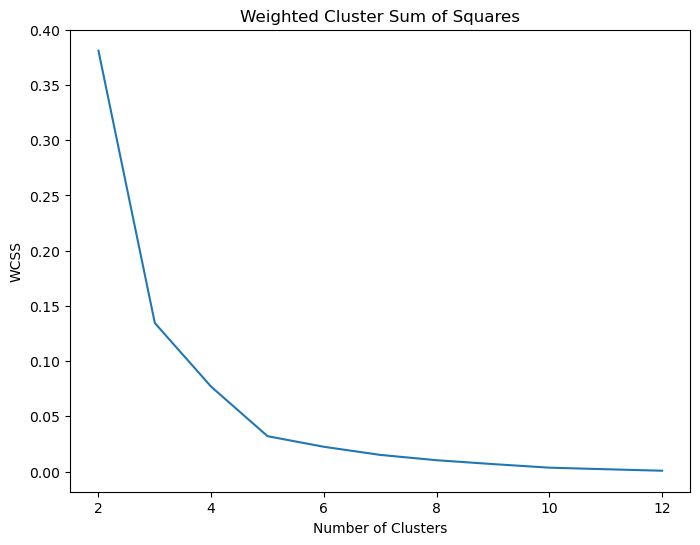

In [51]:
# Using the Elbow method to determine the weighted cluster sum of squares (wcss). This will give us the best  number of clusters to use for this data
wcss = []
for k in range(2,13):
    # create and train the model
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(results)
    wcss.append(kmeans.inertia_)

#plot the data
plt.figure(figsize=(8,6))
plt.plot(range(2,13), wcss)
plt.title('Weighted Cluster Sum of Squares')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

# Cluster size of 5 determined

In [52]:
# Carry out the KMEANS clustering

# Define number of clusters
n_clusters = 5

# Normalizing the data
normalizer = Normalizer()

cluster_model = KMeans(n_clusters = n_clusters, max_iter=1000)
pipeline = make_pipeline(normalizer, cluster_model)
pipeline.fit(pd.DataFrame(results))

labels = pipeline.predict(pd.DataFrame(results))

# Calculate Silhoutte score
kmeans_score = silhouette_score(results, labels, metric='euclidean')
print(kmeans_score)

kmeans_result_df = pd.DataFrame({
        'labels': labels,
        'exchanges': list(results.index)
}).sort_values(by=['labels'], axis=0)


kmeans_result_df

0.12990790302070795


,labels,exchanges
11,0,TWII
1,1,NYA
2,1,IXIC
4,1,N225
7,1,GSPTSE
3,2,000001.SS
6,2,399001.SZ
8,2,NSEI
12,2,J203.JO
5,3,N100


In [53]:
results['Kmeans_labels'] = labels
results

,CAGR(%),Annualized volatiliy,Kmeans_labels
HSI,0.589095,0.256077,4
NYA,0.836211,0.162637,1
IXIC,1.197560,0.198867,1
000001.SS,0.267213,0.245597,2
N225,0.762100,0.201848,1
N100,0.056589,0.208536,3
399001.SZ,0.303536,0.278256,2
GSPTSE,0.606481,0.156617,1
NSEI,0.301061,0.227180,2
GDAXI,0.662398,0.223143,4


In [54]:
# defining set of colours
colors =["green", "orange","yellow", "blue","red"]

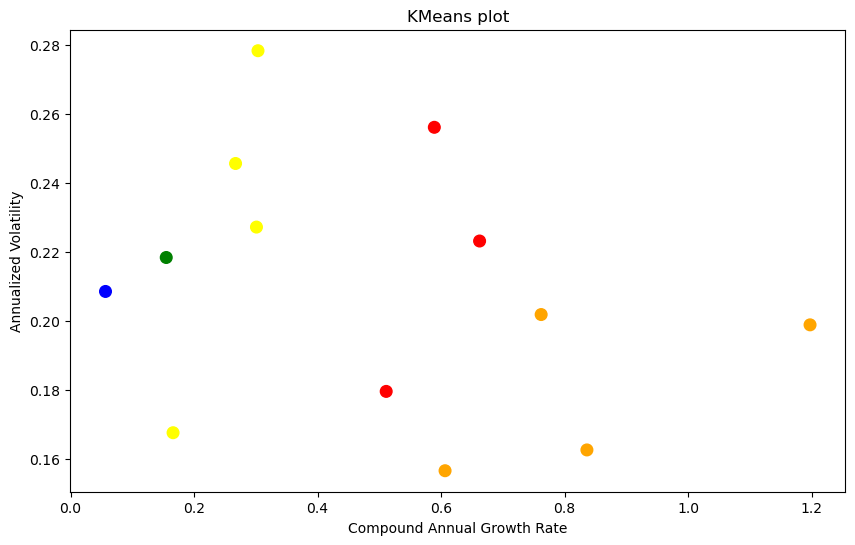

In [55]:
# plot and show the different kmeans clusters
plt.figure(figsize=(10,6))
plt.scatter(results.iloc[:,0], results.iloc[:,1], c=labels, 
            cmap=matplotlib.colors.ListedColormap(colors), s=70
            )
plt.title('KMeans plot')
plt.xlabel('Compound Annual Growth Rate')
plt.ylabel('Annualized Volatility')
plt.show()


### Random Forest

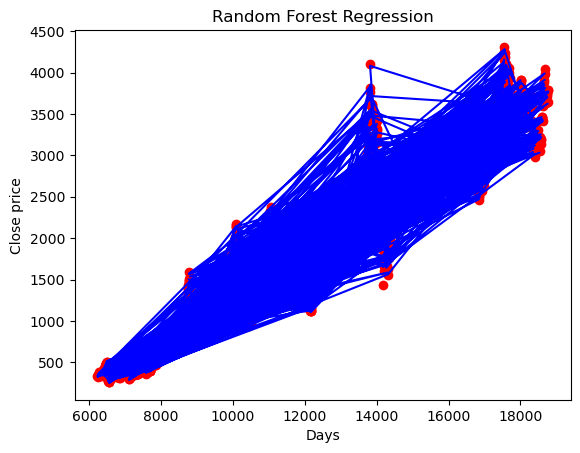

R-squared score HSI : 0.9993361902858487
MAE HSI : 17.349359931167502
RMSE HSI : 4.165256286372725
Accuracy HSI : 0.9993361902858487
Best parameters for HSI: {'max_depth': 20, 'n_estimators': 200}


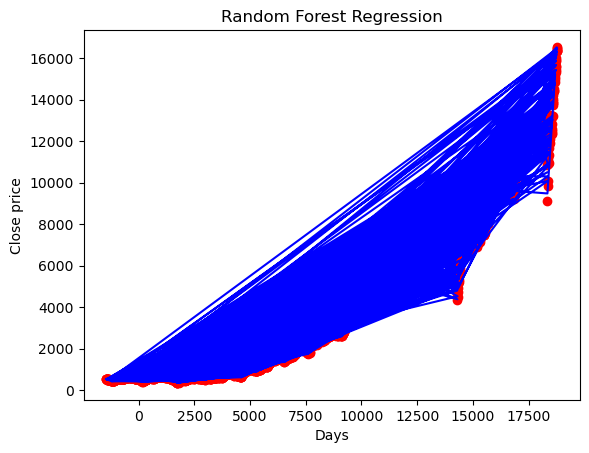

R-squared score NYA : 0.9998139346673297
MAE NYA : 28.518569046747455
RMSE NYA : 5.340277993395798
Accuracy NYA : 0.9998139346673297
Best parameters for NYA: {'max_depth': 20, 'n_estimators': 200}


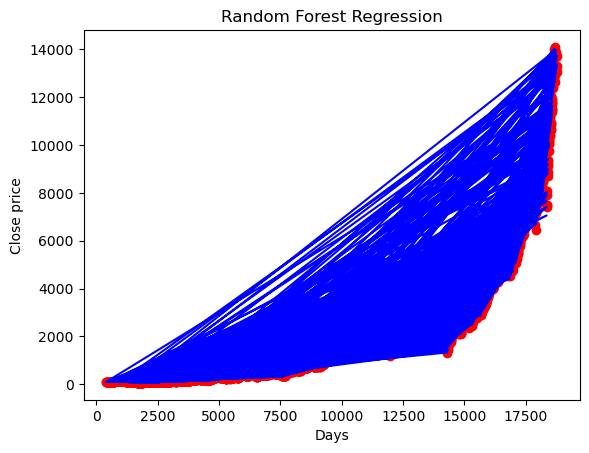

R-squared score IXIC : 0.9997728075879487
MAE IXIC : 16.277176777084307
RMSE IXIC : 4.034498330286469
Accuracy IXIC : 0.9997728075879487
Best parameters for IXIC: {'max_depth': None, 'n_estimators': 200}


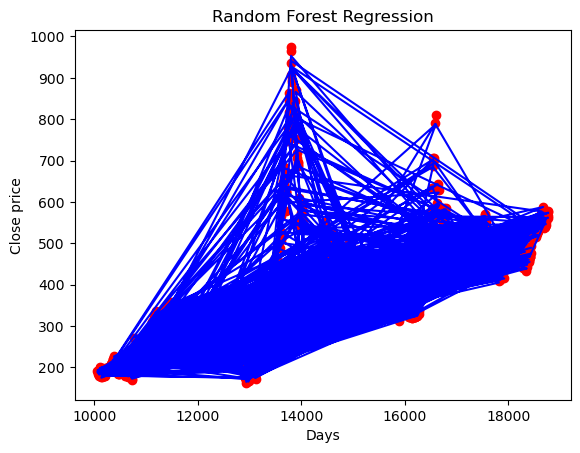

R-squared score 000001.SS : 0.9985266036506492
MAE 000001.SS : 3.498755880418244
RMSE 000001.SS : 1.8704961588889308
Accuracy 000001.SS : 0.9985266036506492
Best parameters for 000001.SS: {'max_depth': 20, 'n_estimators': 100}


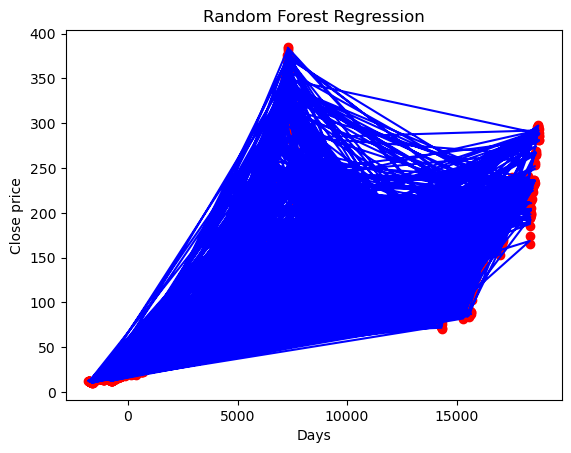

R-squared score N225 : 0.9995791377490041
MAE N225 : 1.012286166572915
RMSE N225 : 1.006124329580055
Accuracy N225 : 0.9995791377490041
Best parameters for N225: {'max_depth': 20, 'n_estimators': 200}


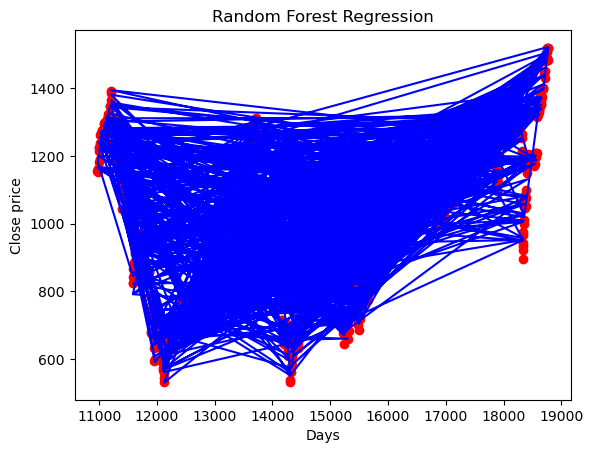

R-squared score N100 : 0.997644785720235
MAE N100 : 7.770330163346053
RMSE N100 : 2.7875311950444703
Accuracy N100 : 0.997644785720235
Best parameters for N100: {'max_depth': 20, 'n_estimators': 200}


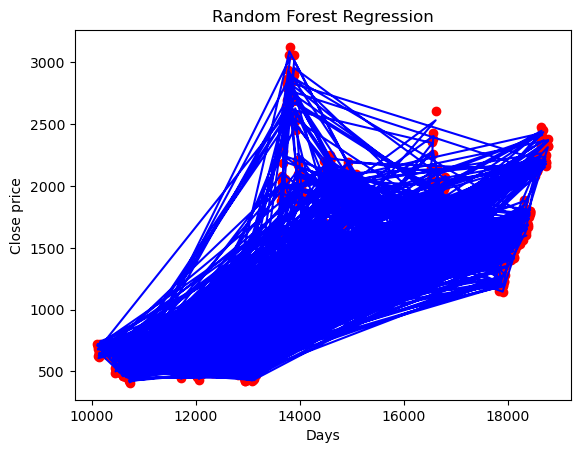

R-squared score 399001.SZ : 0.9986504240714311
MAE 399001.SZ : 14.557712097065721
RMSE 399001.SZ : 3.8154569971453904
Accuracy 399001.SZ : 0.9986504240714311
Best parameters for 399001.SZ: {'max_depth': 20, 'n_estimators': 200}


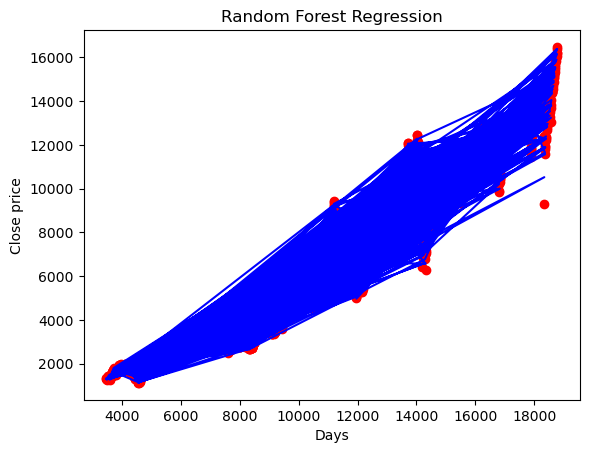

R-squared score GSPTSE : 0.9996862859121212
MAE GSPTSE : 39.94464927575334
RMSE GSPTSE : 6.3201779465259795
Accuracy GSPTSE : 0.9996862859121212
Best parameters for GSPTSE: {'max_depth': 20, 'n_estimators': 200}


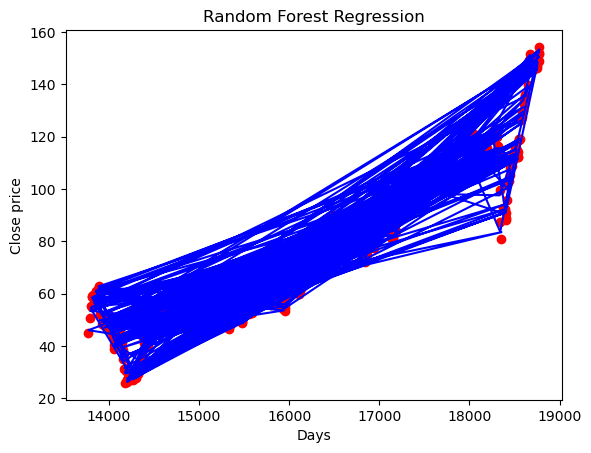

R-squared score NSEI : 0.9993111752777325
MAE NSEI : 0.548914518637007
RMSE NSEI : 0.7408876558811106
Accuracy NSEI : 0.9993111752777325
Best parameters for NSEI: {'max_depth': None, 'n_estimators': 200}


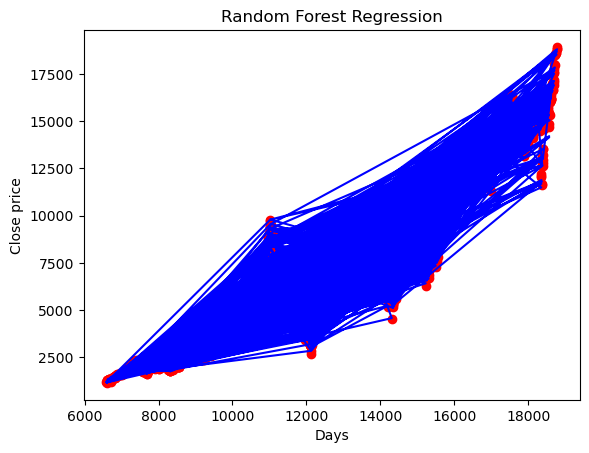

R-squared score GDAXI : 0.9994836449883129
MAE GDAXI : 65.35990938125424
RMSE GDAXI : 8.084547568123664
Accuracy GDAXI : 0.9994836449883129
Best parameters for GDAXI: {'max_depth': 20, 'n_estimators': 200}


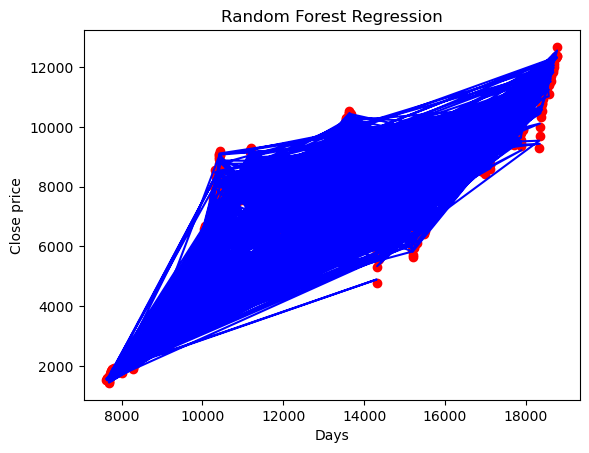

R-squared score SSMI : 0.9993006791178466
MAE SSMI : 49.18438411289544
RMSE SSMI : 7.013157927274662
Accuracy SSMI : 0.9993006791178466
Best parameters for SSMI: {'max_depth': None, 'n_estimators': 100}


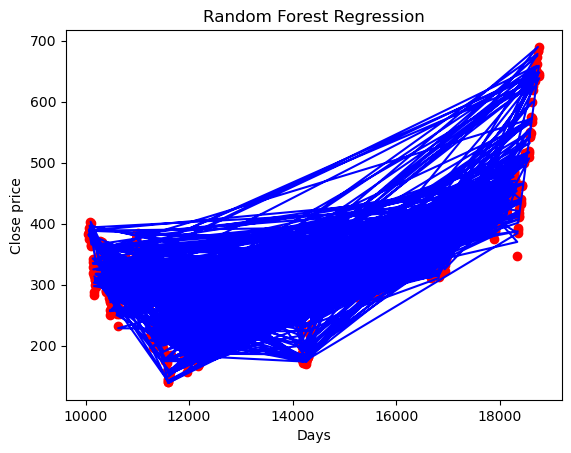

R-squared score TWII : 0.9981670077211865
MAE TWII : 2.6647355362741436
RMSE TWII : 1.6324017692572328
Accuracy TWII : 0.9981670077211865
Best parameters for TWII: {'max_depth': 20, 'n_estimators': 200}


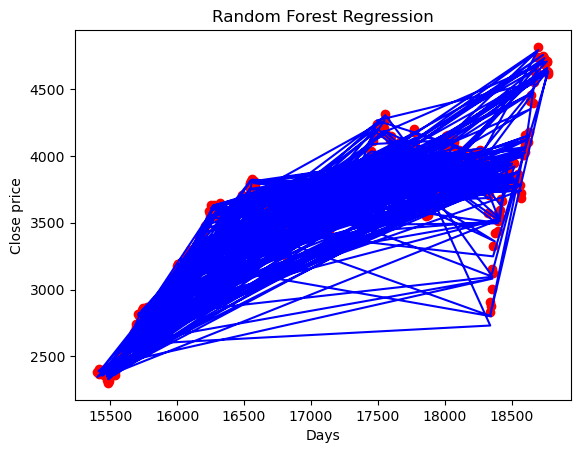

R-squared score J203.JO : 0.9957488759827091
MAE J203.JO : 23.81235629565113
RMSE J203.JO : 4.8797905995699375
Accuracy J203.JO : 0.9957488759827091
Best parameters for J203.JO: {'max_depth': 20, 'n_estimators': 200}


In [68]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

class DataPreparation:
    def __init__(self, df, stcexch):
        self.df = df
        self.stcexch = stcexch
        self.prepare_data()

    def prepare_data(self):
        dfcopy = self.df.copy()
        dfcopy_nya = dfcopy.loc[dfcopy.Index == self.stcexch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)

class RandomForestModel(DataPreparation):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.train_model()

    def train_model(self):
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X.reshape(-1,1), self.y.reshape(-1,1), test_size=0.2, random_state=42)
        parameters = {'n_estimators': [50, 100, 200], 'max_depth': [None, 10, 20, 30]}
        rfr = RandomForestRegressor(random_state=42)
        self.clf = GridSearchCV(rfr, parameters)
        self.clf.fit(self.X_train, self.y_train.ravel())
        self.y_pred = self.clf.predict(self.X_test)

    def get_best_params(self):
        return self.clf.best_params_
    
    def prune(self):
        self.clf = self.clf.best_estimator_
        self.clf.fit(self.X_train, self.y_train.ravel())
        self.y_pred = self.clf.predict(self.X_test)

class Plotting(RandomForestModel):
    def __init__(self, df, stcexch):
        super().__init__(df, stcexch)
        self.plot_data()

    def plot_data(self):
        plt.scatter(self.X_test, self.y_test, color = 'red')
        plt.plot(self.X_test, self.y_pred, color = 'blue')
        plt.title('Random Forest Regression')
        plt.xlabel('Days')
        plt.ylabel('Close price')
        plt.show()
        print('R-squared score',(self.stcexch),':', self.clf.score(self.X_test, self.y_test))
        print('MAE',(self.stcexch),':', mean_absolute_error(self.y_test, self.y_pred))
        print('RMSE',(self.stcexch),':', np.sqrt(mean_absolute_error(self.y_test, self.y_pred)))
        print('Accuracy',(self.stcexch),':', self.clf.score(self.X_test, self.y_test))
        

for exch in df.Index.unique():
    plot = Plotting(df, exch)
    print(f"Best parameters for {exch}: {plot.get_best_params()}")

### LSTM

In [70]:
#applying LSTM model 
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, LSTM

def lstm_model(exch):
    dfcopy = df.copy()
    dfcopy_nya = dfcopy.loc[dfcopy.Index == exch]
    dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
    data = dfcopy_nya.filter(['CloseUSD'])
    dataset = data.values
    training_data_len = int(np.ceil(len(dataset) * .8))
    scaler = MinMaxScaler(feature_range=(0,1))
    scaled_data = scaler.fit_transform(dataset)
    train_data = scaled_data[0:training_data_len, :]
    x_train = []
    y_train = []
    for i in range(60, len(train_data)):
        x_train.append(train_data[i-60:i, 0])
        y_train.append(train_data[i, 0])
    x_train, y_train = np.array(x_train), np.array(y_train)
    x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(x_train.shape[1], 1)))
    model.add(LSTM(50, return_sequences=False))
    model.add(Dense(25))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    model.fit(x_train, y_train, batch_size=1, epochs=1)
    test_data = scaled_data[training_data_len - 60:, :]
    x_test = []
    y_test = dataset[training_data_len:, :]
    for i in range(60, len(test_data)):
        x_test.append(test_data[i-60:i, 0])

    x_test = np.array(x_test)
    x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1))
    predictions = model.predict(x_test)
    predictions = scaler.inverse_transform(predictions)
    rmse = np.sqrt(np.mean(predictions - y_test)**2)
    return predictions, y_test, rmse

# Test the lstm model on all indices
r2_lstm =[]; mae_lstm = []; rmse_lstm =[]
for exch in df.Index.unique():
    y_pred, y, rmse = lstm_model(exch)
    print('Accuracy of ', exch, ':')
    score = calculate_metrics(pred=y_pred, y_test=y)
    r2_lstm.append(score['R^2'])
    mae_lstm.append(score['MAE'])
    rmse_lstm.append(score['RMSE'])

# Show results in a dataframe
table_lstm = pd.DataFrame(index=df.Index.unique())
table_lstm['R-squared'] = r2_lstm
table_lstm['MAE'] = mae_lstm
table_lstm['RMSE'] = rmse_lstm
table_lstm



2023-11-22 19:31:25.149958: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-11-22 19:31:30.726361: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


54/54 [==============================] - 2s 13ms/step
Accuracy of  HSI :
{'R^2': 0.829, 'MAE': 148.98703, 'RMSE': 12.206}
88/88 [==============================] - 2s 12ms/step
Accuracy of  NYA :
{'R^2': 0.993, 'MAE': 143.31517, 'RMSE': 11.971}
80/80 [==============================] - 2s 12ms/step
Accuracy of  IXIC :
{'R^2': 0.991, 'MAE': 187.6325, 'RMSE': 13.698}
37/37 [==============================] - 1s 12ms/step
Accuracy of  000001.SS :
{'R^2': 0.954, 'MAE': 7.34691, 'RMSE': 2.711}
87/87 [==============================] - 2s 12ms/step
Accuracy of  N225 :
{'R^2': 0.996, 'MAE': 2.61652, 'RMSE': 1.618}
35/35 [==============================] - 1s 13ms/step
Accuracy of  N100 :
{'R^2': 0.938, 'MAE': 20.69862, 'RMSE': 4.55}
36/36 [==============================] - 1s 13ms/step
Accuracy of  399001.SZ :
{'R^2': 0.985, 'MAE': 27.13182, 'RMSE': 5.209}
66/66 [==============================] - 2s 12ms/step
Accuracy of  GSPTSE :
{'R^2': 0.951, 'MAE': 249.17788, 'RMSE': 15.785}
21/21 [===========

,R-squared,MAE,RMSE
HSI,0.829,148.98703,12.206
NYA,0.993,143.31517,11.971
IXIC,0.991,187.63250,13.698
000001.SS,0.954,7.34691,2.711
N225,0.996,2.61652,1.618
N100,0.938,20.69862,4.550
399001.SZ,0.985,27.13182,5.209
GSPTSE,0.951,249.17788,15.785
NSEI,0.861,5.23969,2.289
GDAXI,0.954,307.09372,17.524


### MLP

In [69]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split

from sklearn.model_selection import GridSearchCV

def mlp_model(exch):
    dfcopy = df.copy()
    dfcopy_nya = dfcopy.loc[dfcopy.Index == exch]
    dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
    y = np.asarray(dfcopy_nya['CloseUSD'])
    X = np.asarray(dfcopy_nya.index.values)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    parameters = {'hidden_layer_sizes': [(50,50,50), (100,100,100), (50,100,50)], 'max_iter': [500,1000,1500]}
    mlp = MLPRegressor(random_state=42)
    clf = GridSearchCV(mlp, parameters)
    clf.fit(X_train.reshape(-1,1), y_train.reshape(-1,1).ravel())
    y_pred = clf.predict(X_test.reshape(-1,1))
    return y_test, y_pred, clf.best_params_

# Test the mlp model on all indices
r2_mlp =[]; mae_mlp = []; rmse_mlp =[]; best_params_mlp = []
for exch in df.Index.unique():
    y, y_pred, best_params = mlp_model(exch)
    print('Accuracy of ', exch, ':')
    score = calculate_metrics(pred=y_pred, y_test=y)
    r2_mlp.append(score['R^2'])
    mae_mlp.append(score['MAE'])
    rmse_mlp.append(score['RMSE'])
    best_params_mlp.append(best_params)

# Show results in a dataframe
table_mlp = pd.DataFrame(index=df.Index.unique())
table_mlp['R-squared'] = r2_mlp
table_mlp['MAE'] = mae_mlp
table_mlp['RMSE'] = rmse_mlp
table_mlp['Best Params'] = best_params_mlp
table_mlp


Accuracy of  HSI :
{'R^2': 0.747, 'MAE': 453.55079, 'RMSE': 21.297}
Accuracy of  NYA :
{'R^2': 0.952, 'MAE': 554.63421, 'RMSE': 23.551}
Accuracy of  IXIC :
{'R^2': 0.537, 'MAE': 1207.14987, 'RMSE': 34.744}
Accuracy of  000001.SS :
{'R^2': 0.376, 'MAE': 80.47724, 'RMSE': 8.971}
Accuracy of  N225 :
{'R^2': 0.585, 'MAE': 37.0086, 'RMSE': 6.083}
Accuracy of  N100 :
{'R^2': 0.118, 'MAE': 169.57819, 'RMSE': 13.022}
Accuracy of  399001.SZ :
{'R^2': 0.397, 'MAE': 393.98141, 'RMSE': 19.849}
Accuracy of  GSPTSE :
{'R^2': 0.847, 'MAE': 1421.3287, 'RMSE': 37.701}
Accuracy of  NSEI :
{'R^2': 0.372, 'MAE': 19.26507, 'RMSE': 4.389}
Accuracy of  GDAXI :
{'R^2': 0.643, 'MAE': 2310.70475, 'RMSE': 48.07}
Accuracy of  SSMI :
{'R^2': 0.674, 'MAE': 1342.87621, 'RMSE': 36.645}
Accuracy of  TWII :
{'R^2': 0.434, 'MAE': 54.07342, 'RMSE': 7.353}
Accuracy of  J203.JO :
{'R^2': 0.49, 'MAE': 279.76788, 'RMSE': 16.726}


,R-squared,MAE,RMSE,Best Params
HSI,0.747,453.55079,21.297,"{'hidden_layer_sizes': (50, 50, 50), 'max_iter..."
NYA,0.952,554.63421,23.551,"{'hidden_layer_sizes': (50, 50, 50), 'max_iter..."
IXIC,0.537,1207.14987,34.744,"{'hidden_layer_sizes': (50, 100, 50), 'max_ite..."
000001.SS,0.376,80.47724,8.971,"{'hidden_layer_sizes': (100, 100, 100), 'max_i..."
N225,0.585,37.00860,6.083,"{'hidden_layer_sizes': (50, 50, 50), 'max_iter..."
N100,0.118,169.57819,13.022,"{'hidden_layer_sizes': (50, 50, 50), 'max_iter..."
399001.SZ,0.397,393.98141,19.849,"{'hidden_layer_sizes': (50, 100, 50), 'max_ite..."
GSPTSE,0.847,1421.32870,37.701,"{'hidden_layer_sizes': (50, 100, 50), 'max_ite..."
NSEI,0.372,19.26507,4.389,"{'hidden_layer_sizes': (100, 100, 100), 'max_i..."
GDAXI,0.643,2310.70475,48.070,"{'hidden_layer_sizes': (50, 50, 50), 'max_iter..."


### SVM

In [ ]:
from sklearn.svm import SVR
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt

class BaseModel:
    def __init__(self, df, exch):
        self.df = df.copy()
        self.exch = exch
        self.prepare_data()

    def prepare_data(self):
        dfcopy_nya = self.df.loc[self.df.Index == self.exch]
        dfcopy_nya.index = (dfcopy_nya.index - pd.to_datetime('1970-01-01')).days
        self.y = np.asarray(dfcopy_nya['CloseUSD'])
        self.X = np.asarray(dfcopy_nya.index.values)
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=0.2, random_state=42)

class SVMModel(BaseModel):
    def __init__(self, df, exch):
        super().__init__(df, exch)
        self.parameters = {'kernel': ['linear', 'rbf'], 'C': [0.1, 1, 10, 100]}
        self.svr = SVR()
        self.clf = GridSearchCV(self.svr, self.parameters)

    def train_model(self):
        self.clf.fit(self.X_train.reshape(-1,1), self.y_train.reshape(-1,1).ravel())
        self.y_pred = self.clf.predict(self.X_test.reshape(-1,1))
        return self.y_test, self.y_pred, self.clf.best_params_

class Plotter:
    @staticmethod
    def plot_results(y_test, y_pred):
        plt.figure(figsize=(10, 6))
        plt.plot(y_test, label='True')
        plt.plot(y_pred, label='Predicted')
        plt.legend()
        plt.show()

# Test the svm model on all indices
r2_svm =[]; mae_svm = []; rmse_svm =[]; best_params_svm = []
for exch in df.Index.unique():
    model = SVMModel(df, exch)
    y, y_pred, best_params = model.train_model()
    print('Accuracy of ', exch, ':')
    score = calculate_metrics(pred=y_pred, y_test=y)
    r2_svm.append(score['R^2'])
    mae_svm.append(score['MAE'])
    rmse_svm.append(score['RMSE'])
    best_params_svm.append(best_params)
    Plotter.plot_results(y, y_pred)

# Show results in a dataframe
table_svm = pd.DataFrame(index=df.Index.unique())
table_svm['R-squared'] = r2_svm
table_svm['MAE'] = mae_svm
table_svm['RMSE'] = rmse_svm
table_svm['Best Params'] = best_params_svm
table_svm